In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

In [4]:
from IPython.display import Audio

In [5]:
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = 20, 10
mpl.rcParams['lines.linewidth'] = 3
mpl.rcParams['font.size'] = 20
mpl.rcParams['lines.markersize'] = 15
mpl.rcParams['axes.grid'] = True
# mpl.rcParams.find_all('')

# UE Signal-Optimisation-Apprentissage-Physique - Séance 3

# Un exemple d'applications: music information retrieval
* Music Information Retrieval (MIR)?
* Les tâches et applications

### Music Information Retrieval
Un ensemble de tâches et d'application où des **connaissances musicales de haut niveau** sont **automatiquement extraites de sons bruts**.

Caractéristiques:
* données sonores, musicales;
* méthodes de traitement de signal et apprentissage automatique;
* nombreuses briques de bases communes aux différentes tâches.


### MIR: une possible catégorisation des tâches
* Annotation locale: l'information recherchée évolue dans le temps au cours d'un morceau. *Exemple: les notes jouées.*
* Annotation globale d'un morceau: l'information recherchée concerne le morceau tout entier. *Exemple: le genre d'un morceau.*
* Navigation dans des bases de son: on souhaite faire des recherches rapides dans des grandes bases de sons. *Exemple: Shazam.*
* Problèmes inverses: on souhaite produire des sons, pas seulement des informations. *Exemple: déréverberation.*


#### Les tâches d'annotation locale du contenu de morceaux

<img src="./figures/exemple_transcription.png" alt="exemple_transcription" width="500" height="600">
(src: Benetos et al.,  Automatic Music Transcription: An Overview, 2018.)

Principales tâches et informations recherchées
* **détection d'attaques** (*onset detection*): changement soudain d'énergie, de contenu spectral, etc.
* **estimation de tempo** (*tempo estimation}): le tempo et ses variations au cours du morceau, souvent à partir des attaques; variantes: *beat, downbeat estimation}.
* **estimation de hauteur simple** (*pitch estimation*): périodicité dans le domaine temporel, distribution harmonique des partiels dans le domaine fréquentiel, inharmonicité
* **estimation de hauteurs multiples** (*multipitch estimation*): superposition de hauteurs simples avec de nombreuses interférences entre les notes en rapport harmonique.
* **estimation d'accords** (*chord estimation*): fondamentale, type d'accord (M, m, 7, maj7, min7, etc.).
* **détection d'instrument**: présence/absence des sources en fonction du temps.
* **segmentations**: structure musicale (AABA, refrain/couplet, etc.), sources actives (nombre, identité), etc.

**Découpage temporel pour l'analyse des sons:**

<img src="./figures/exemple_trames_yi.png" alt="tags" width="800">

En général, on découpe un son en segments régulièrement espacés, avec recouvrement, appelés **trames** (*frames*). Par exemple, une trame de 30 à 200 ms avec recouvrement de 50% pour l'estimation de hauteur.

Plusieurs formats possibles pour le résultat de la tâche:
* échantillonnage régulier: par exemple, un tempo toutes les 100ms, les hauteurs toutes les 30ms.
* découpage selon l'événement: par exemple, instant des attaques, début et fin de chaque note, de chaque accord.

#### Les tâches d'annotation globale des morceaux

<img src="./figures/wordcloudc.png" alt="tags" width="800">

* **Genre**: une seule ou plusieurs classes possibles (multilabel)
* **Compositeur**
* **Artiste**
* **Métrique** (meter)
* **Tonalité** (key)
* ***Mood***: *passionate, rousing, confident, boisterous, rowdy; rollicking, cheerful, fun, sweet, amiable/good natured; literate, poignant, wistful, bittersweet, autumnal, brooding; humorous, silly, campy, quirky, whimsical, witty, wry; aggressive, fiery, tense/anxious, intense, volatile, visceral.*
* **Tags divers**: nombre important de classes.


#### Les tâches de navigation dans des bases de son

<img src="./figures/512px-Shazam_logo.png" alt="shazam logo" width="200">

* **Fingerprinting**: extraire un code court et discriminant pour caractériser un morceau; utile pour les requêtes dans de grandes bases.
* **Reconnaissance à partir d'un extrait**: Shazam!
* **Cover song identification**: reconnaitre le morceau original à partir d'une interprétation, une reprise, un arrangement.
* **Requête par fredonnement/tapping** (*Query by Humming/Tapping*): un extrait largement déformé et partiel du morceau original.
* **Set list identification**: reconnaissance des morceaux et segmentation de la video d'un concert entier.
* **Recommandation de musique**: à partir des métadonnées et/ou des goûts (*like*).

#### Au-delà du MIR: les problèmes inverses

<img src="./figures/musheader.41c6bf29.png" alt="source sep" width="500">

Exemples de séparation de sources musicales:

* [une bonne séparation](https://sisec18.unmix.app/#/unmix/Lyndsey%20Ollard%20-%20Catching%20Up/IRM2)
* [une moins bonne séparation](https://sisec18.unmix.app/#/unmix/Lyndsey%20Ollard%20-%20Catching%20Up/HEL1) : déformation de la source estimée, résidus des autres sources, ajout d'artefacts

Tâches:

* **Séparation de sources**: séparer les pistes de chaque instrument, démixer, isoler les percussions, séparer chant et accompagnement; avec un ou plusieurs capteurs (micros); mélanges instantanés (gain), anéchoïque (gain et délai), convolutifs (filtres, réverbération).
* **Débruitage** (*denoising*): une source d'intérêt, une source de bruit.
* **Déréverbération**: estimation de réponse impulsionnelle, modélisation des fonctions de Green, etc.
* **Inpainting**: reconstruction de données manquantes; clicks, clipping, paquets manquants, masquage temps-fréquence.
* **Voice conversion**: garder le contenu (paroles, mélodie), changer le style (locuteur, timbre)

## Structure typique d'un système
Deux grandes étapes successives: **Extraction de descripteurs** (*features*) puis **Classification/régression**.

| |
| :-: |
| input |
| $\downarrow$ |
| **Extraction de descripteurs**  |
| $\downarrow$ |
| **Classification/régression** |
| $\downarrow$ |
| output |

Remarques:
* principe utilisé pour tous types de données: sons, images, texte, etc.
* évolutions historiques:
  * premiers systèmes: 100% traitement du signal;
  * systèmes très répandus: traitement du signal pour la construction des représentations et apprentissage pour la prise de décision;
  * systèmes récents: 100% apprentissage; apprentissage de représentation, système de bout en bout (end-to-end), au prix d'une complexité énorme. Voir prochaine séance.

## Objectifs de ce notebook

* Se familiariser avec les spectrogrammes
* Features standards pour l'audio et l'image:
  * Connaitre les principaux
  * Comprendre leur construction
  * Savoir les manipuler

La notion de représentation est centrale!

$\Rightarrow$ On s'intéresse aux **représentations expertes** avant de passer à des approches plus récentes d'apprentissage de représentations.

# Notion de spectrogramme

$\rightarrow$ au centre des représentations en audio

* Exemples de spectrogrammes
* Définition et paramètres du spectrogramme

In [6]:
from soap_tf import compute_stft, show_spectrogram
from soap_utils import plot_sound, plot_spectrum, db, add_noise, snr
from soap_io import read_wav, write_wav
sound_path = Path('./data/')
sound_path1 = Path('../../data/sons_int1/')
sound_path2 = Path('../../data/sons_int2/')

## Exemple de spectrogrammes
* Des notes isolées
* Un morceau de piano
* Une sinusoïde
* $N$ sinusoïdes
* Chirps linéaire et quadratique

### Notes isolées

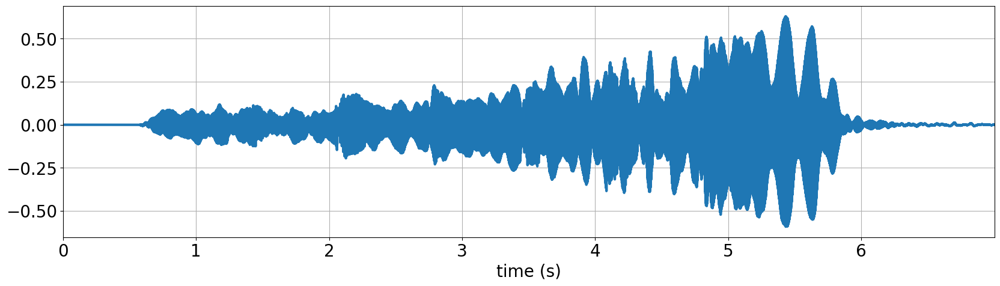

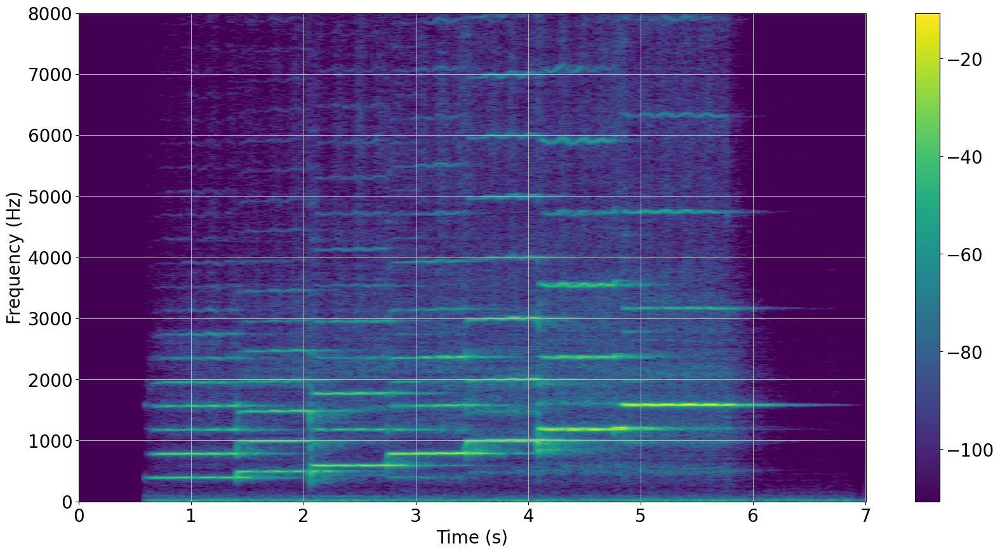

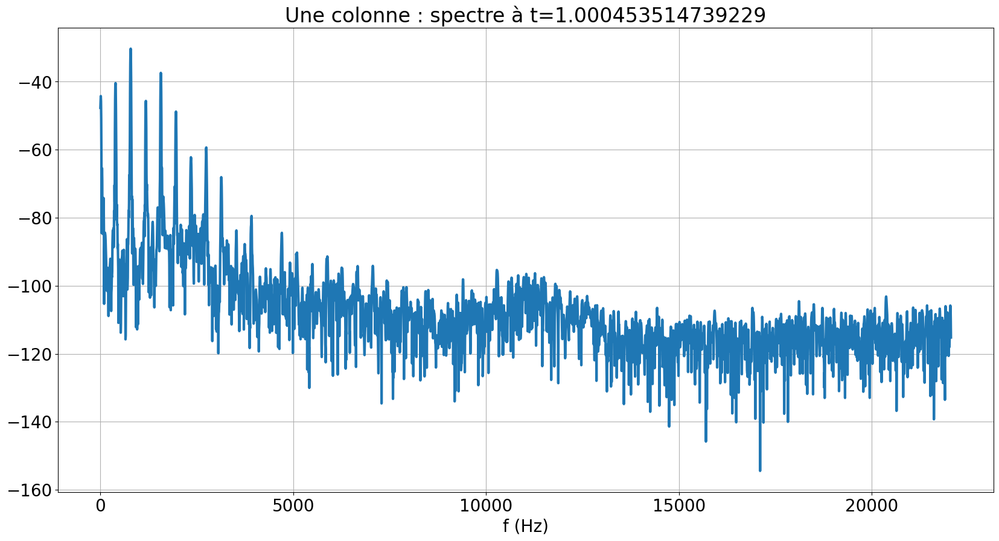

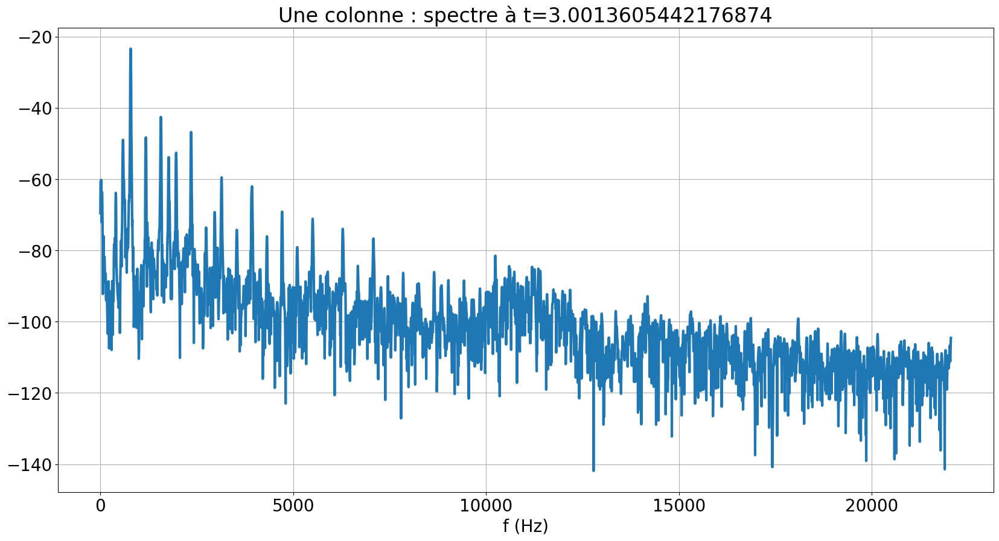

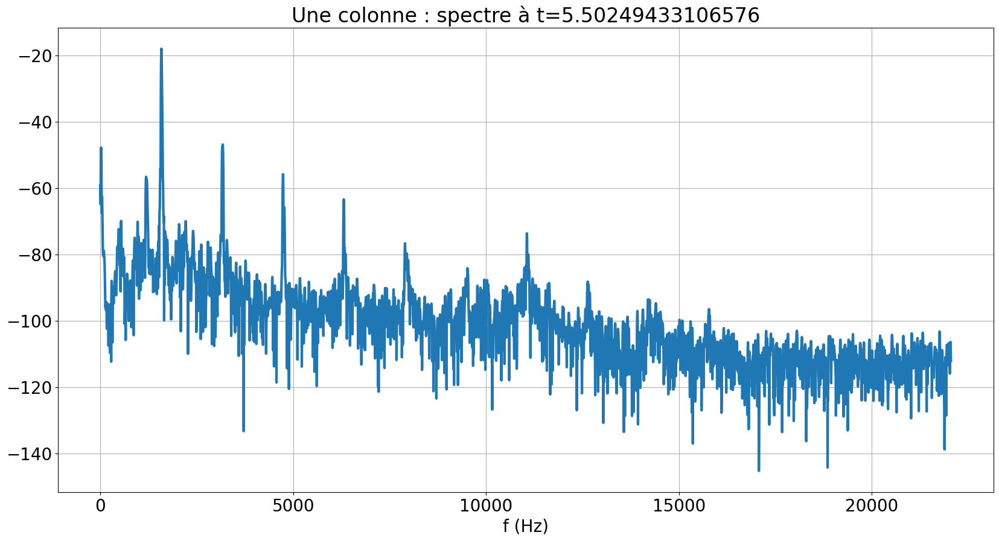

In [7]:
sound_file = sound_path1 / '13.wav'
fs, x = read_wav(sound_file)
# x = x[17*fs:29*fs, 0]
x = x[:7*fs, 0]

stft_params = {
    'seg_dur': 0.1,  # durée de chaque trame/segment
    'nfft': 8192,  # nombre de fréquences discrètes de chaque DFT
    'overlap_ratio':0.75,  # taux de recouvrement entre les trames
    'window': 'hann',  # fenêtre de pondération pour chaque trame
}
f, t, X = compute_stft(x, fs, **stft_params)

plt.figure(figsize=(20, 5))
plot_sound(x, fs)
plt.xlim(0, (x.size-1)/fs)

plt.figure()
show_spectrogram(f, t, X)
plt.colorbar()
plt.ylim(0, 8000)

# Période d'échantillonnage du spectrogramme (pas, en seconde)
hop_dur = (1 - stft_params['overlap_ratio']) * stft_params['seg_dur']
for k in [int(1/hop_dur), int(3/hop_dur), int(5.5/hop_dur), ]:
    plt.figure()
    plt.plot(f, db(X[:, k]))
    plt.xlabel('f (Hz)')
    plt.title('Une colonne : spectre à t={}'.format(t[k]))

Audio(filename=sound_path / (sound_file.stem + '.mp3'))

### Un morceau de piano

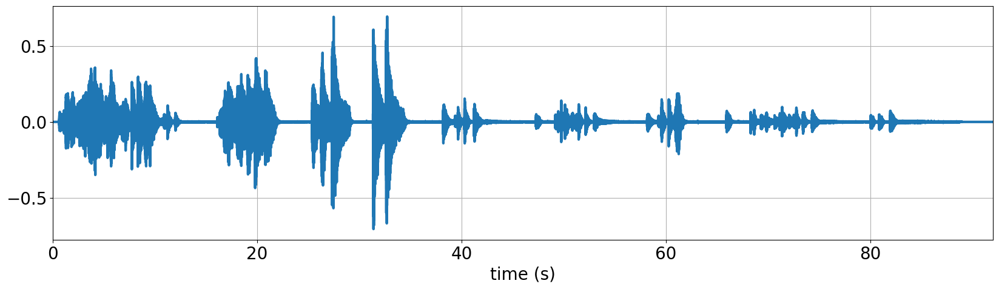

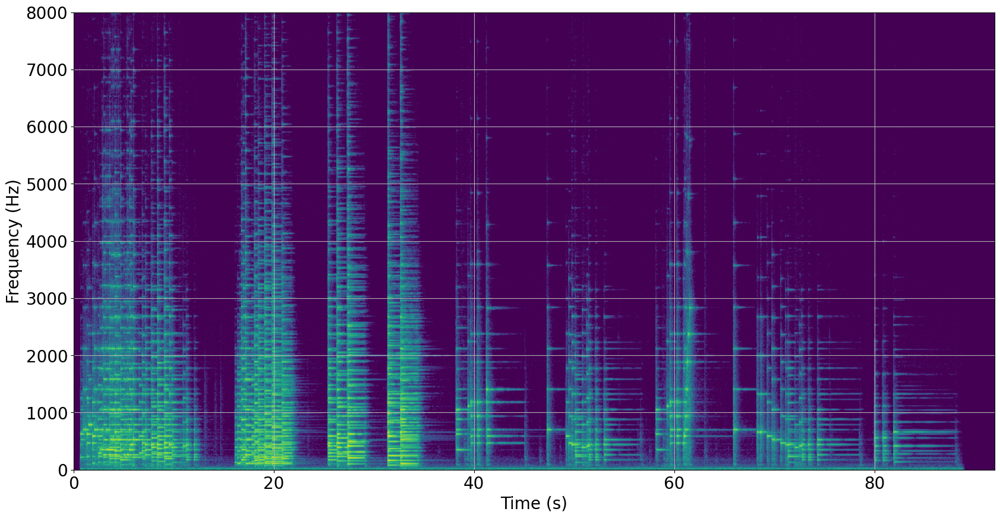

In [8]:
sound_file = sound_path2 / '60.wav'
fs, x = read_wav(sound_file)
x = x[:, 0]

stft_params = {
    'seg_dur': 0.1,
    'nfft': None,
    'overlap_ratio':0.2,
    'window': 'hann',
}
f, t, X = compute_stft(x, fs, **stft_params)

plt.figure(figsize=(20, 5))
plot_sound(x, fs)
plt.xlim(0, (x.size-1)/fs)

plt.figure()
show_spectrogram(f, t, X)
plt.ylim(0, 8000)
Audio(filename=sound_path / (sound_file.stem + '.mp3'))

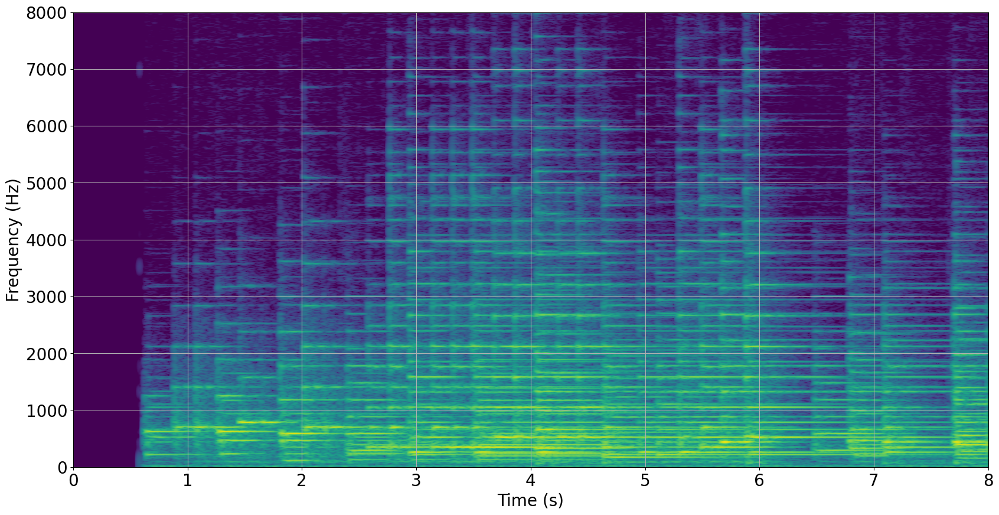

In [9]:
x0 = x[:8*fs]
stft_params = {
    'seg_dur': 0.1,
    'nfft': None,
    'overlap_ratio':0.9,
    'window': 'hann',
}
f, t, X = compute_stft(x0, fs, **stft_params)
plt.figure()
show_spectrogram(f, t, X)
plt.ylim(0, 8000)
Audio(data=x0, rate=fs)

### Une sinusoide

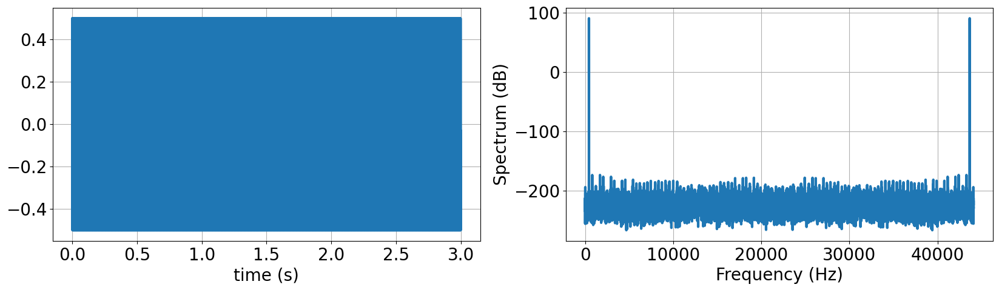

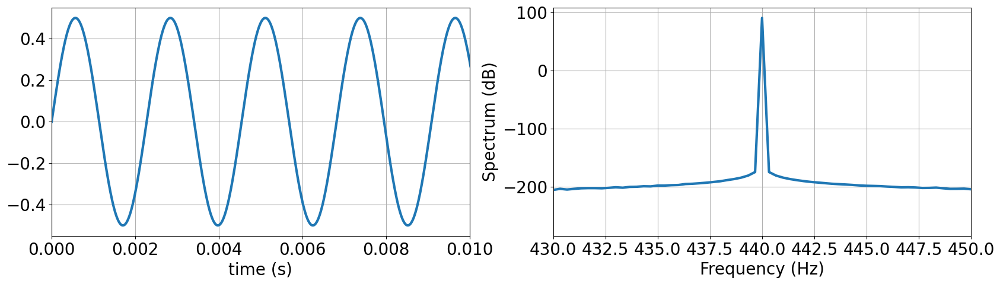

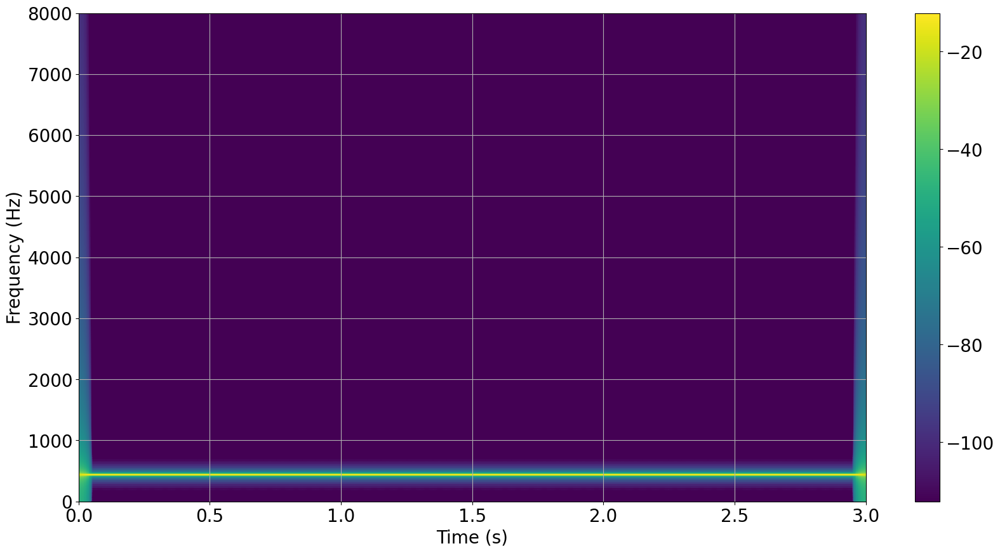

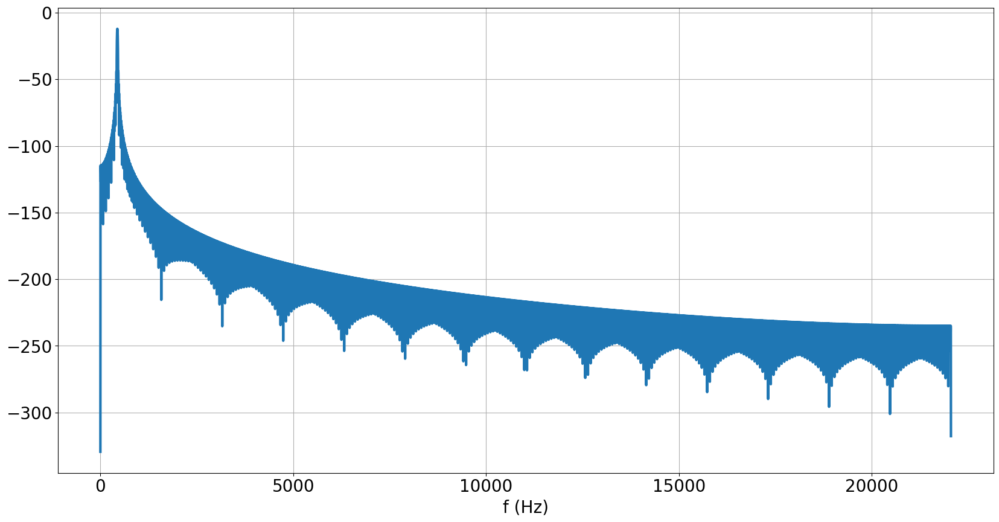

In [10]:
duration = 3
f0 = 440
t = np.arange(0, duration, 1/fs)
x = 0.5 * np.sin(2*np.pi*f0*t)
write_wav(x=x, fs=fs, filename='sin440.wav')

f, t, X = compute_stft(x, fs, **stft_params)

plt.figure(figsize=(20, 5))
plt.subplot(121)
plot_sound(x, fs)
plt.subplot(122)
plot_spectrum(x, fs)

plt.figure(figsize=(20, 5))
plt.subplot(121)
plot_sound(x, fs)
plt.xlim(0, 0.01)
plt.subplot(122)
plot_spectrum(x, fs)
plt.xlim(430, 450)

plt.figure()
show_spectrogram(f, t, X)
plt.ylim(0, 8000)
plt.colorbar()

plt.figure()
plt.plot(f, db(X[:, 10]))
plt.xlabel('f (Hz)')
Audio(data=x, rate=fs)

### $N$ sinusoides

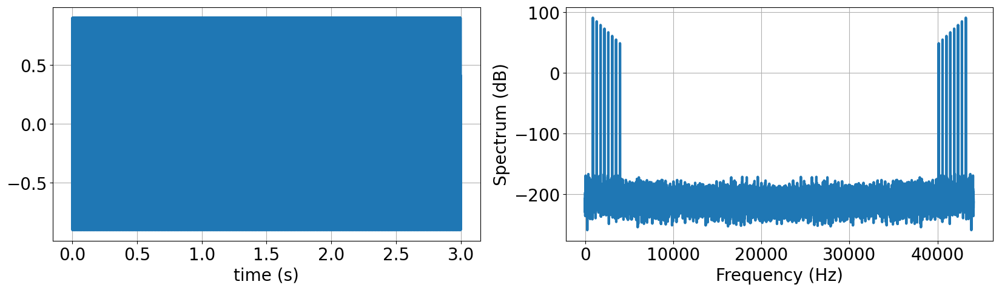

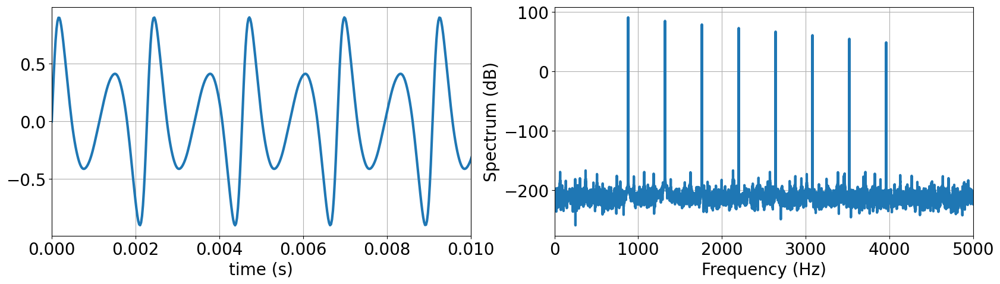

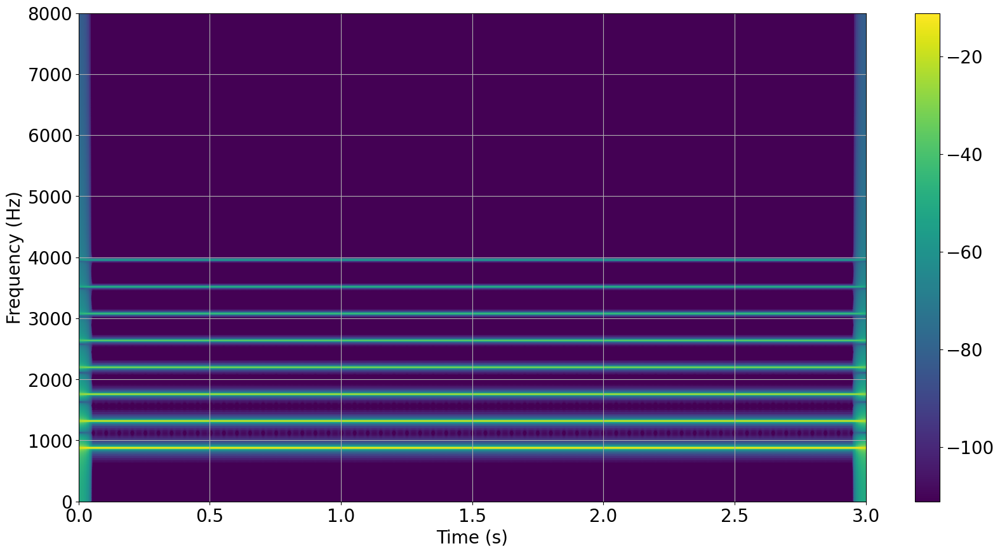

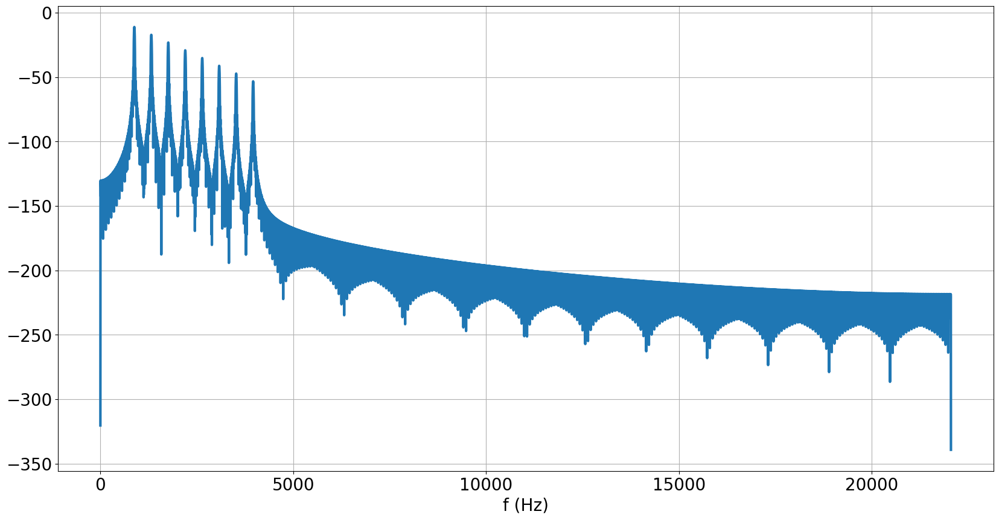

In [11]:
duration = 3
f0 = 440
tx = np.arange(0, duration, 1/fs)
x = np.zeros_like(tx)
for m in range(2, 10):
    x += 2**(-m) * np.sin(2*np.pi*m*f0*tx)
x *= 0.9 / np.max(np.abs(x))  # normalisation
write_wav(x=x, fs=fs, filename='n_sin440.wav')

f, t, X = compute_stft(x, fs, **stft_params)

plt.figure(figsize=(20, 5))
plt.subplot(121)
plot_sound(x, fs)
plt.subplot(122)
plot_spectrum(x, fs)

plt.figure(figsize=(20, 5))
plt.subplot(121)
plot_sound(x, fs)
plt.xlim(0, 0.01)
plt.subplot(122)
plot_spectrum(x, fs)
plt.xlim(0, 5000)

plt.figure()
show_spectrogram(f, t, X)
plt.ylim(0, 8000)
plt.colorbar()

plt.figure()
plt.plot(f, db(X[:, 10]))
plt.xlabel('f (Hz)')
Audio(data=x, rate=fs)

### Un chirp
Un chirp est une composante sinusoïdale dont la fréquence varie lentement:

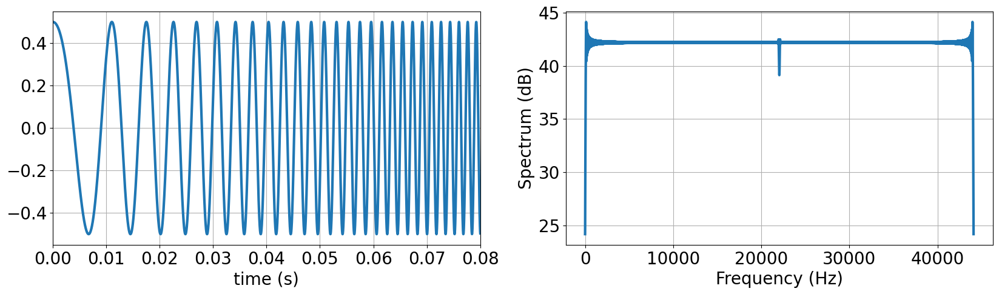

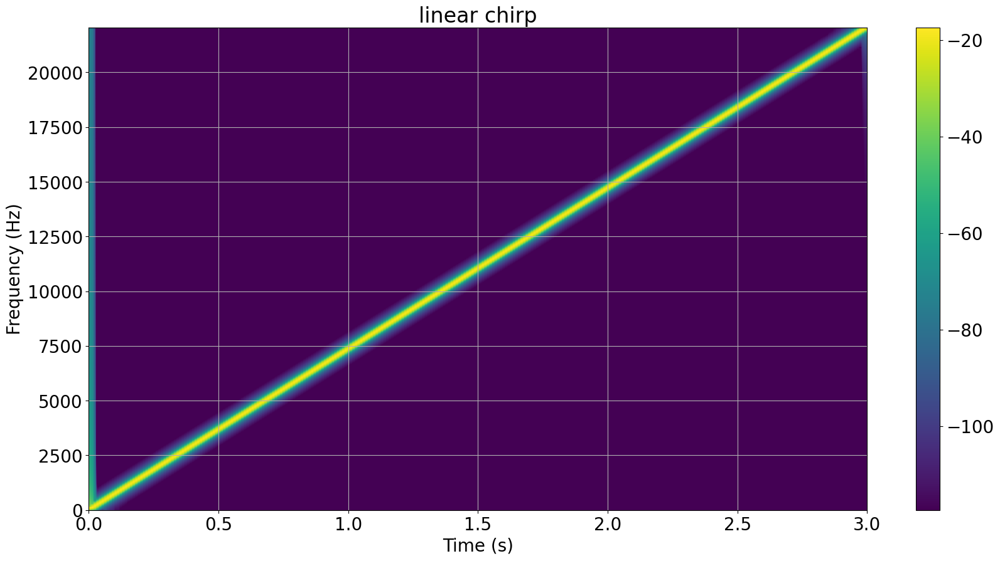

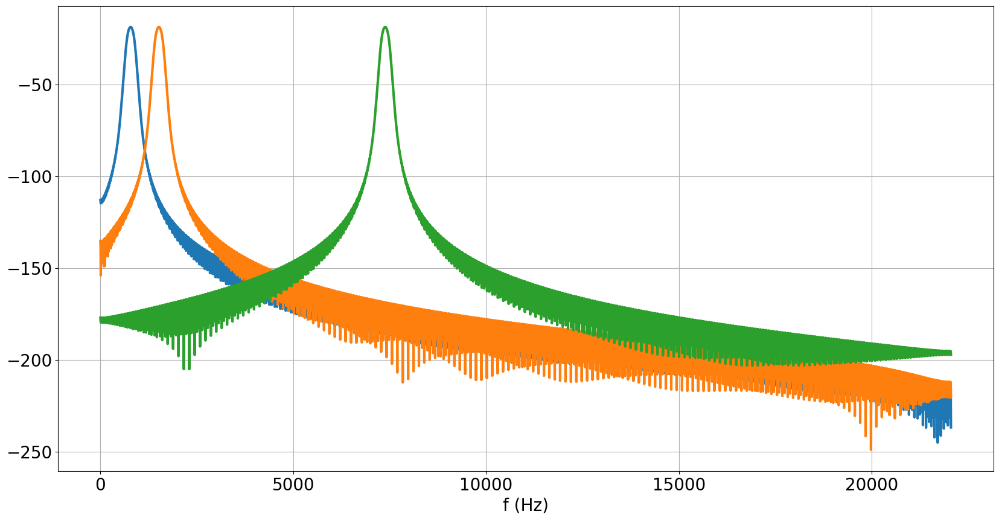

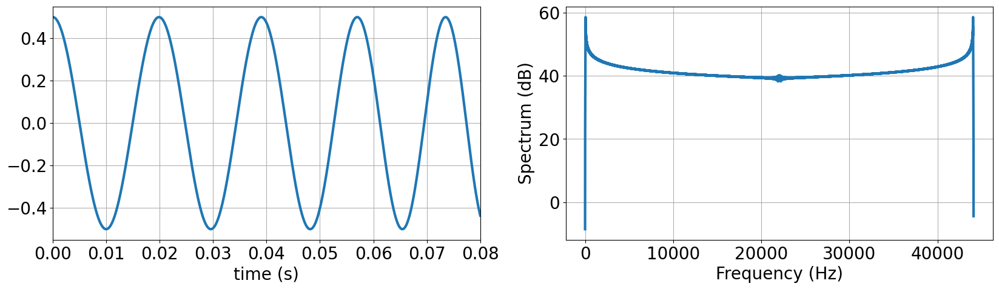

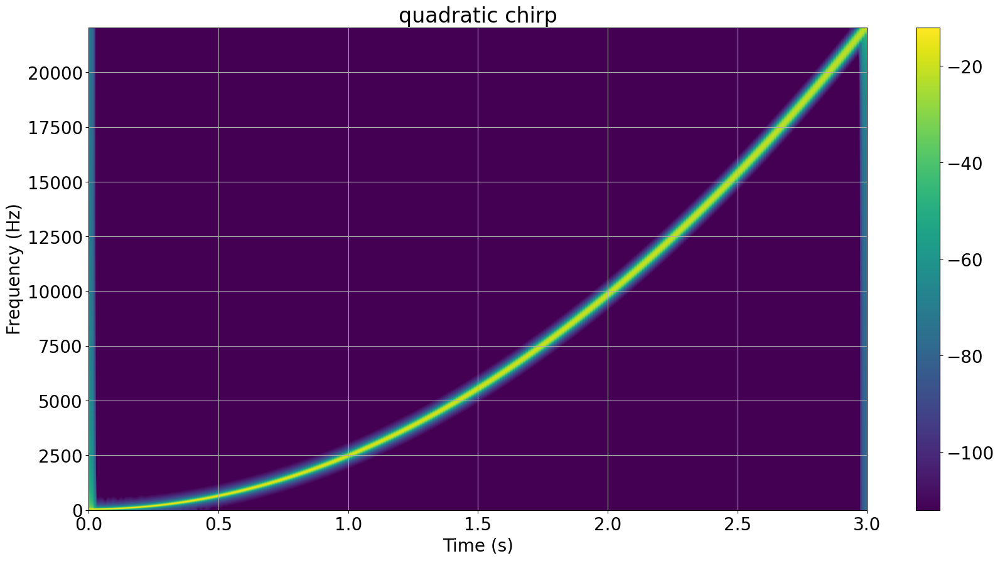

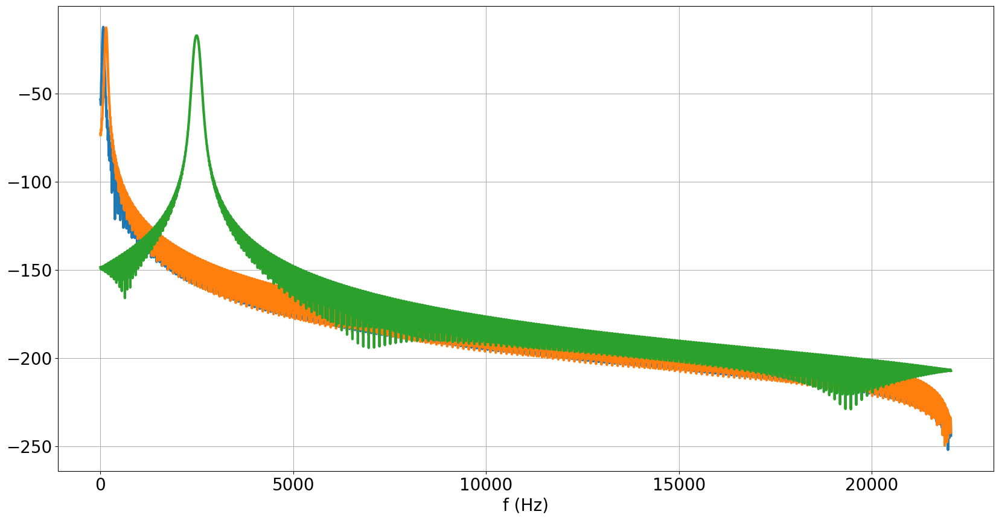

In [12]:
from scipy.signal import chirp
duration = 3
f0 = 50  # Fréquence de départ
f1 = fs / 2  # Fréquence d'arrivée

tx = np.arange(0, duration, 1/fs)
stft_params = {
    'seg_dur': 0.05,
    'nfft': None,
    'overlap_ratio':0.8,
    'window': 'hann',
}
sounds = {}
for method in ['linear', 'quadratic']:
    x = 0.5 * chirp(t=tx, f0=f0, t1=tx[-1], f1=f1, method=method)
    write_wav(x=x, fs=fs, filename=method + '_chirp.wav')

    f, t, X = compute_stft(x, fs, **stft_params)

    plt.figure(figsize=(20, 5))
    plt.subplot(121)
    plot_sound(x, fs)
    plt.xlim(0, 0.08)
    plt.subplot(122)
    plot_spectrum(x, fs)

    plt.figure()
    show_spectrogram(f, t, X)
    plt.colorbar()
    plt.title(method + ' chirp')
    
    plt.figure()
    plt.plot(f, db(X[:, 10]))
    plt.plot(f, db(X[:, 20]))
    plt.plot(f, db(X[:, 100]))
    plt.xlabel('f (Hz)')
    sounds[method] = x
Audio(data=sounds['linear'], rate=fs)

In [13]:
Audio(data=sounds['quadratic'], rate=fs)

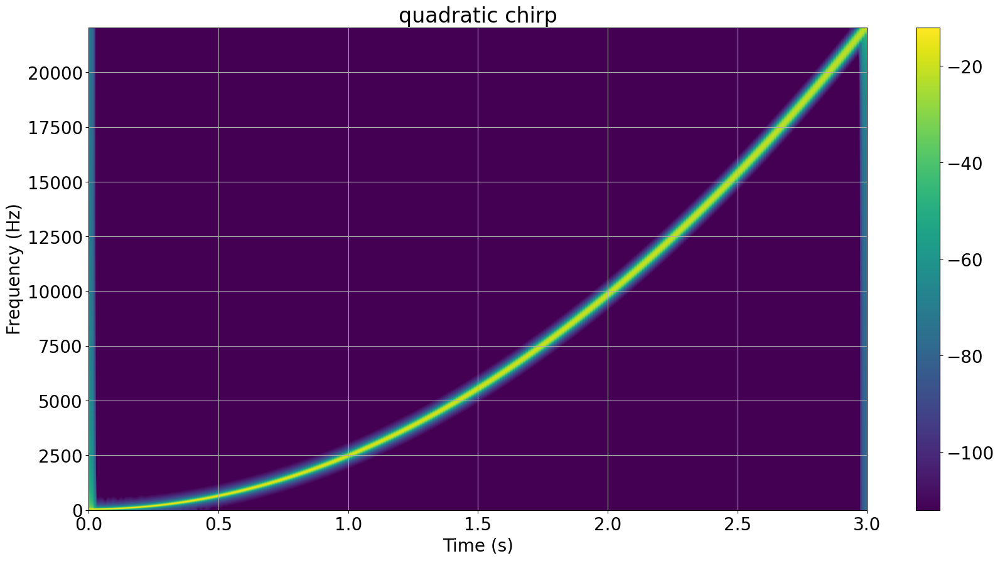

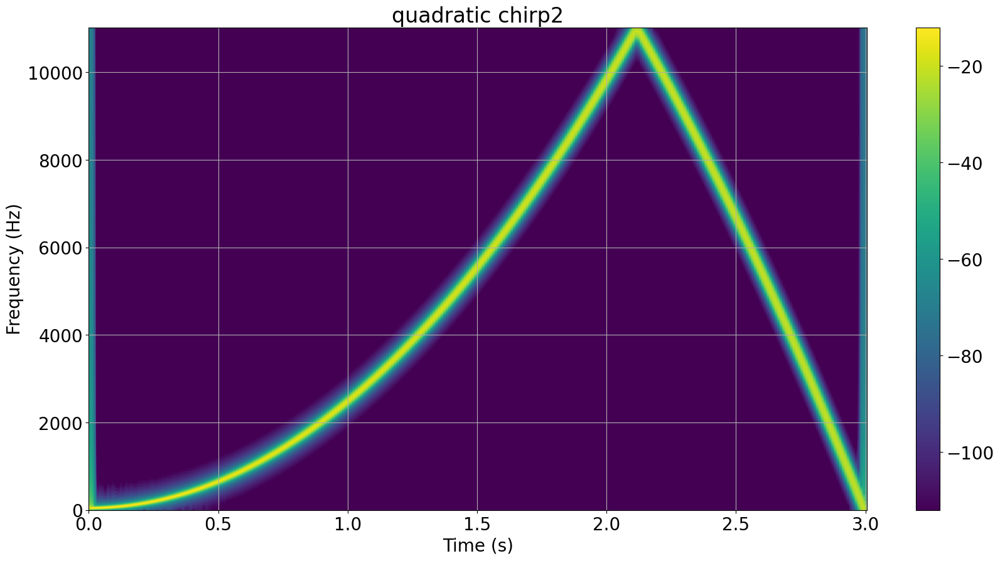

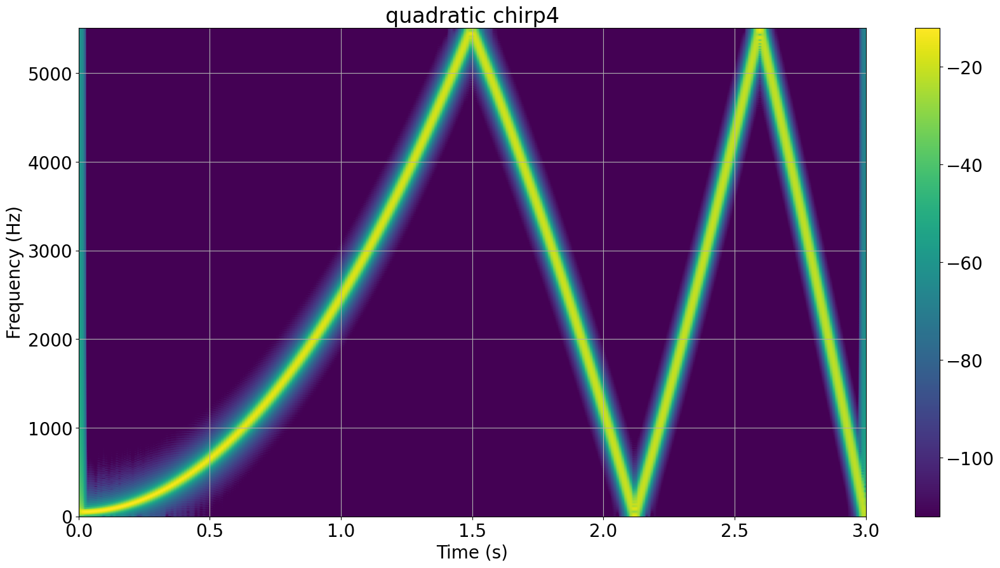

In [14]:
# Effet d'un sous-échantillonnage sans précaution

from scipy.signal import chirp
duration = 3
f0 = 50
f1 = fs / 2

tx = np.arange(0, duration, 1/fs)
stft_params = {
    'seg_dur': 0.05,
    'nfft': None,
    'overlap_ratio':0.8,
    'window': 'hann',
}

method = 'quadratic'
x = 0.5 * chirp(t=tx, f0=f0, t1=tx[-1], f1=f1, method=method)
x2 = x[::2]
fs2 = fs // 2
x4 = x[::4]
fs4 = fs // 4
write_wav(x=x2, fs=fs2, filename=method + '_chirp2.wav')
write_wav(x=x4, fs=fs4, filename=method + '_chirp4.wav')

f, t, X = compute_stft(x, fs, **stft_params)

plt.figure()
show_spectrogram(f, t, X)
plt.colorbar()
plt.title(method + ' chirp')

f, t, X2 = compute_stft(x2, fs2, **stft_params)
plt.figure()
show_spectrogram(f, t, X2)
plt.colorbar()
plt.title(method + ' chirp2')

f, t, X4 = compute_stft(x4, fs4, **stft_params)
plt.figure()
show_spectrogram(f, t, X4)
plt.colorbar()
plt.title(method + ' chirp4')
Audio(data=x, rate=fs)

In [15]:
Audio(data=x2, rate=fs2)

In [16]:
Audio(data=x4, rate=fs4)

## Définition et paramètres du spectrogramme

Maintenant que vous avez l'intuition du spectrogramme, comment bien en extraire vous-même?

* Notations et définitions
* Choix du pas et nombre de fréquences
* Forme et taille de la fenêtre
* Interprétation comme un banc de filtres

### Notations et définitions

**Le spectrogramme est le module au carré de la *transformée de Fourier à court terme*.** Quésako?

<img src="./figures/construction_spectrogramme.png" alt="construction spectro" width="700">

Pour un signal $\mathbf{x}\in\mathbb{R}^L$, un entier $M \ll L$, on considère des trames de taille $M$ espacées d'un pas entier $h<M$:
$$\mathbf{x}^{(n)}=\begin{bmatrix}\mathbf{x}\left[t_n\right]\\ \mathbf{x}\left[t_n+1\right]\\ \vdots\\ \mathbf{x}\left[t_n+M-1\right]\end{bmatrix}\in\mathbb{R}^M$$
où $t_n = h\times n$ est l'indice du début de la $n$-ième trame.

En fixant une fenêtre $\mathbf{w}\in\mathbb{R}^M$, la version fenêtrée de la $n$-ième trame est définie par $$\mathbf{x}_{\mathbf{w}}^{(n)} = \mathbf{x}^{(n)} . \mathbf{w}$$

En considérant un nombre de fréquences discrètes $K\geq M$, la **transformée de Fourier à court terme** de $\mathbf{x}$ (TFCT, en anglais STFT *short-time Fourier transform*) est une matrice $\mathbf{X}$ définie par:
$$
\mathbf{X}[k, n] 
= \text{DFT}\left\lbrace\mathbf{x}_{\mathbf{w}}^{(n)}\right\rbrace\left[k\right]
= \sum_{m=0}^{M-1} \mathbf{x}\left[t_n+m\right] \mathbf{w}\left[m\right] e^{-2i\pi\frac{k m}{K}}
$$
où $k$ est l'indice de la fréquence discrète $\nu_k=\frac{k}{K}$ avec $0 \leq k < K$ et n est l'indice de la trame commençant en $t_n$.

Le **spectrogramme** $\mathbf{S}$ est la matrice obtenue en prenant le carré des modules des éléments de $\mathbf{X}[k, n]$:
$$\mathbf{S}[k, n]  = \left|\mathbf{X}[k, n]\right|^2$$
Le spectrogramme est en général représenté sous la forme d'une image, en dB : $10\log_{10}\left(\mathbf{S}\right)=20\log_{10}\left(\left|\mathbf{X}[k, n]\right|\right)$.

### Choix du pas et nombre de fréquences

Le pas (ou hop size, recouvrement, overlap, stride) permet de choisir la discrétisation temporelle pour la segmentation en trames:

/Users/vemiya/versioned/enseignement/ue-soap/seance3_representations/code/soap_tf.py:34: RuntimeWarning: divide by zero encountered in log10
  X = 20*np.log10(np.abs(X))


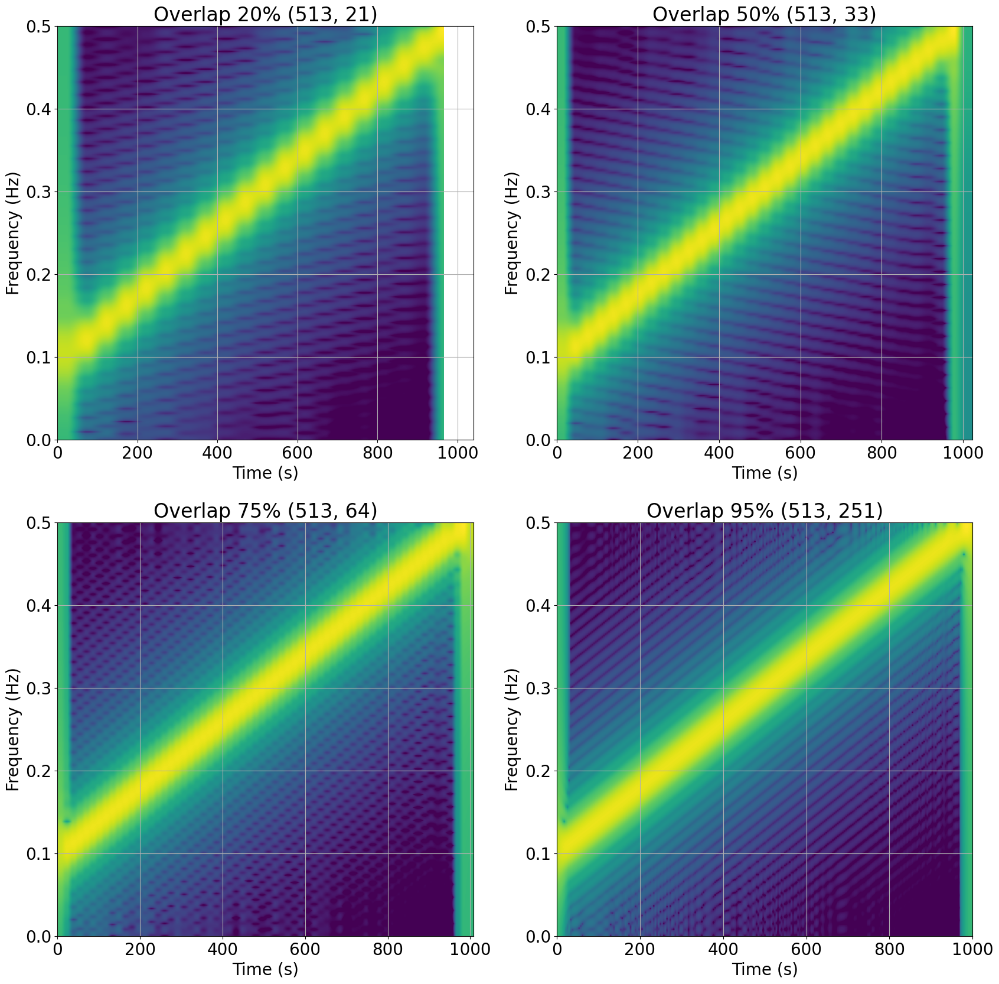

In [17]:
x_length = 1000
x = 0.5 * chirp(t=np.arange(x_length), f0=0.1, t1=x_length, f1=0.5, method='linear')

stft_params = {
    'seg_dur': 64,
    'nfft': 1024,
    'overlap_ratio': None,
    'window': 'hann',
}

plt.figure(figsize=(20, 20))

for i, overlap_ratio in enumerate([0.2, 0.5, 0.75, 0.95]):
    stft_params['overlap_ratio'] = overlap_ratio
    f, t, X = compute_stft(x, fs=1, **stft_params)
    plt.subplot(2, 2, i+1)
    show_spectrogram(f, t, X)
    plt.title('Overlap {:.0%} {}'.format(overlap_ratio, X.shape))


Le nombre de fréquences (ou nombre de bins, taille de la DFT/FFT) permet de choisir la discrétisation fréquentielle:

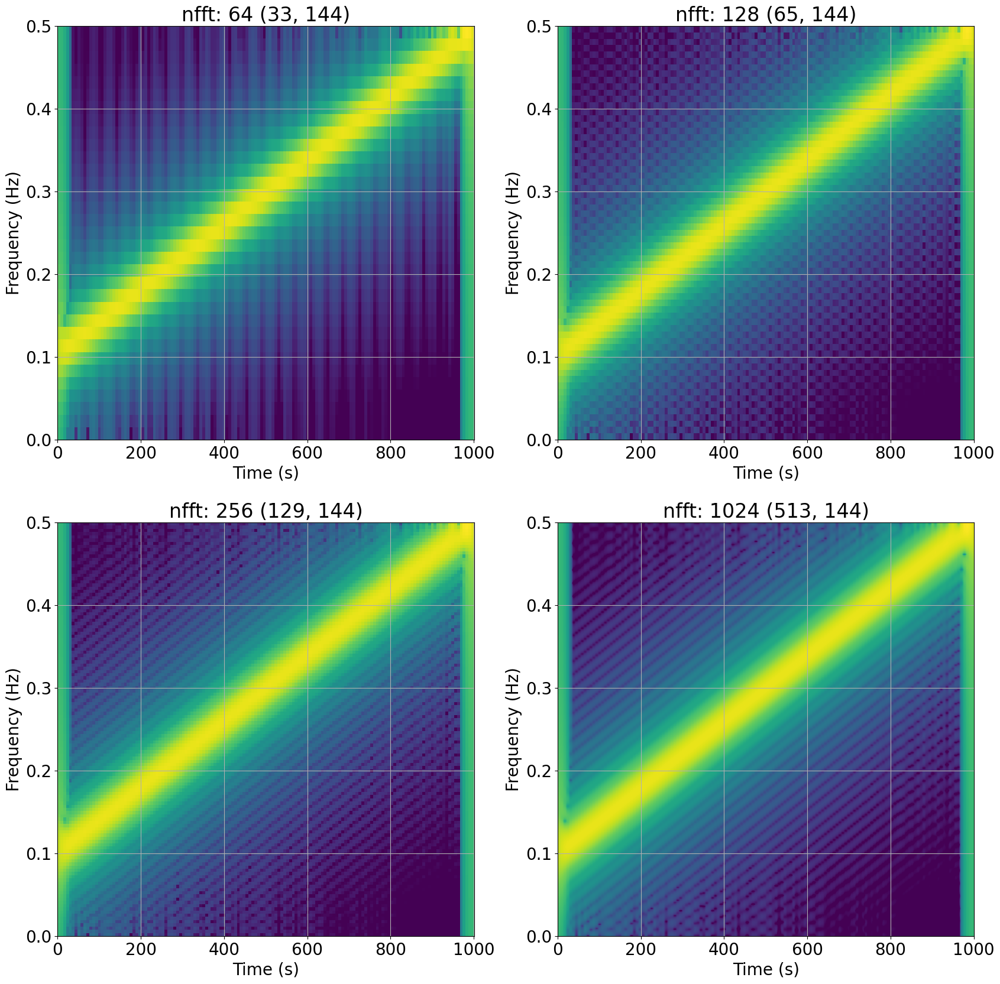

In [18]:
x_length = 1000
x = 0.5 * chirp(t=np.arange(x_length), f0=0.1, t1=x_length, f1=0.5, method='linear')

stft_params = {
    'seg_dur': 64,
    'nfft': None,
    'overlap_ratio':0.9,
    'window': 'hann',
}

plt.figure(figsize=(20, 20))

for i, nfft in enumerate([64, 128, 256, 1024]):
    stft_params['nfft'] = nfft
    f, t, X = compute_stft(x, fs=1, **stft_params)
    plt.subplot(2, 2, i+1)
    show_spectrogram(f, t, X)
    plt.title('nfft: {} {}'.format(nfft, X.shape))


### Forme et taille de la fenêtre
On s'intéresse ici au choix de la fenêtre $\mathbf{w}$ et à sa taille $M$.

In [19]:
from scipy.signal.windows import hann, hamming

Plus la taille de la fenêtre est grande, plus la résolution fréquentielle est élevée, et plus la résolution temporelle est faible. Illustration par l'analyse d'un signal composé

* d'un sinus à la fréquence $f_0$
* d'une impulsion à l'instant $t=1$

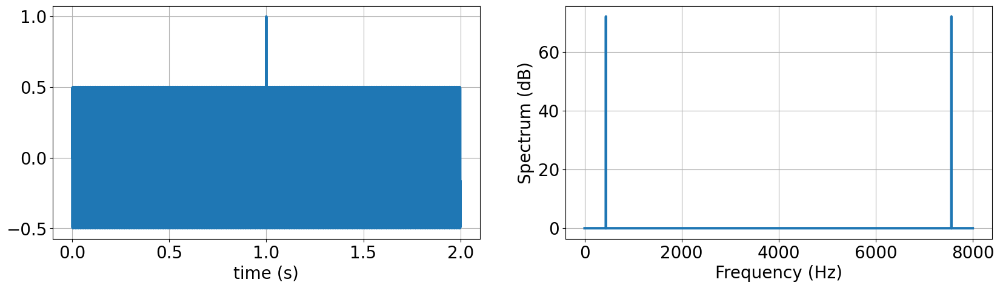

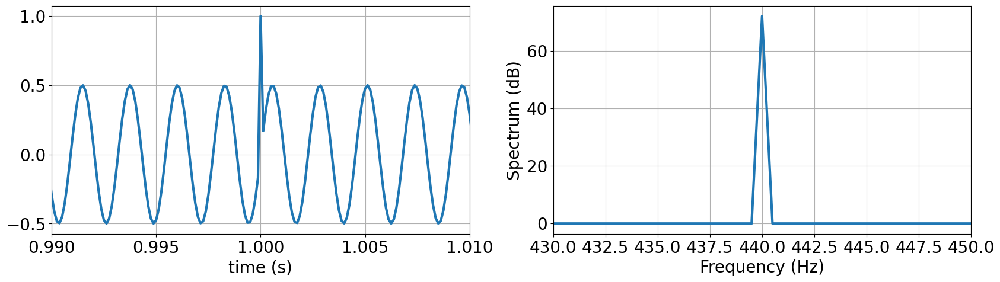

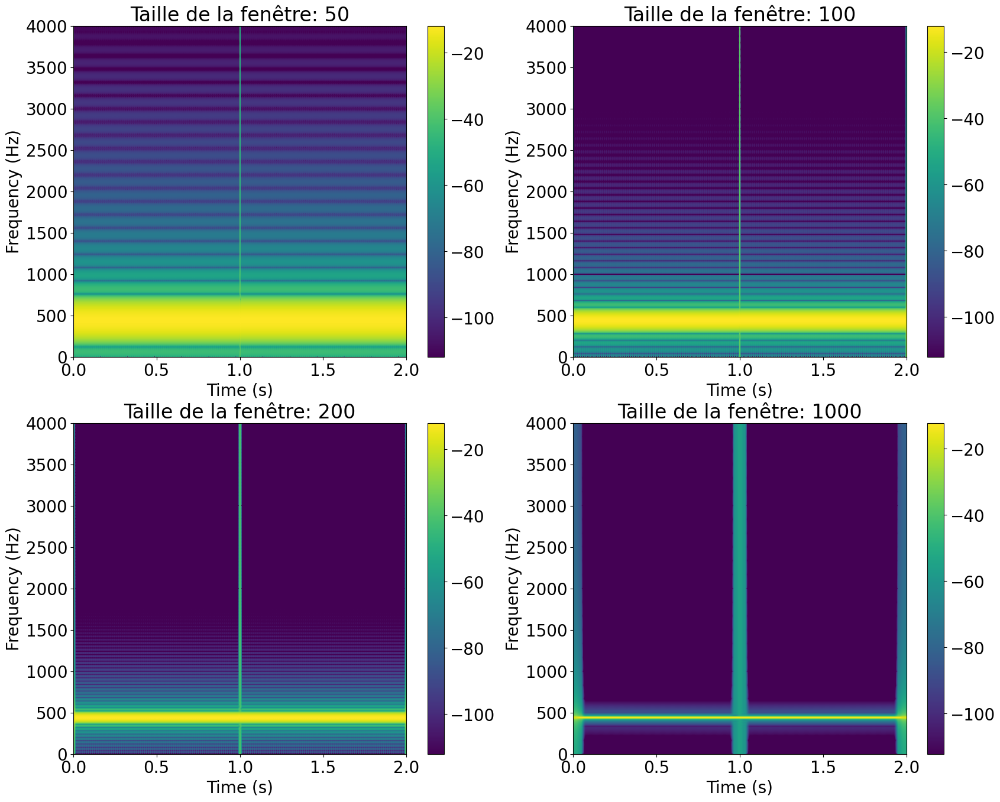

In [20]:
duration = 2
fs =8000
f0 = 440
t = np.arange(0, duration, 1/fs)
x = 0.5 * np.sin(2*np.pi*f0*t)  # Un sinus de fréquence f0
x[fs] = 1  #  Une impulsion (dirac)
write_wav(x=x, fs=fs, filename='sin440.wav')

plt.figure(figsize=(20, 5))
plt.subplot(121)
plot_sound(x, fs)
plt.subplot(122)
plot_spectrum(x, fs)

plt.figure(figsize=(20, 5))
plt.subplot(121)
plot_sound(x, fs)
plt.xlim(0.99, 1.01)
plt.subplot(122)
plot_spectrum(x, fs)
plt.xlim(430, 450)

n_fft = 2048
plt.figure(figsize=(20, 16))
for i, win_len in enumerate([50, 100, 200, 1000]):
    stft_params = {
        'seg_dur': win_len/fs,
        'nfft': n_fft,
        'overlap_ratio':0.75,
        'window': 'hann',
    }
    f, t, X = compute_stft(x, fs, **stft_params)
    plt.subplot(2, 2, i+1)
    show_spectrogram(f, t, X)
    plt.colorbar()
    plt.grid(False)
    plt.title('Taille de la fenêtre: {}'.format(win_len))


De manière équivalente, on peut observer que la taille de la fenêtre est inversement proportionnelle à la largeur des *lobes* de sa transformée de Fourier.

Dans le spectrogramme d'un son, une trame est la multiplication du signal par la fenêtre (translatée): la DFT d'une trame est donc la convolution de la DFT du signal et de la DFT de la fenêtre. Ceci explique l'étalement de la sinusoide dans les spectrogrammes précédents.

/Users/vemiya/versioned/enseignement/ue-soap/seance3_representations/code/soap_utils.py:51: RuntimeWarning: divide by zero encountered in log10
  return 20 * np.log10(np.abs(x))


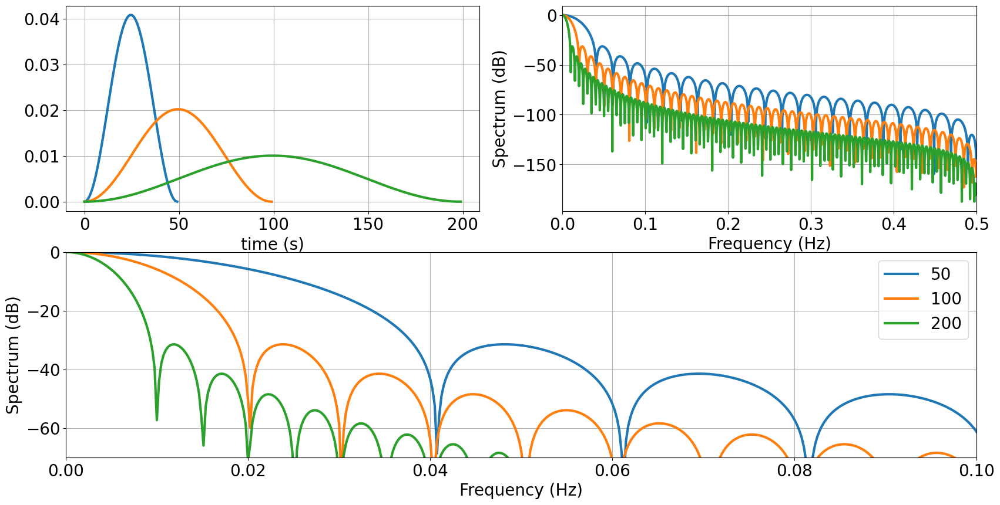

In [21]:
n_fft = 4096
plt.figure()
ax1 = plt.subplot(221)
ax2 = plt.subplot(222)
ax3 = plt.subplot(212)

for win_len in [50, 100, 200]:
    w = hann(win_len)
    w /= np.sum(w)  # normalisation, optionnelle
    
    plt.sca(ax1)
    plot_sound(w, fs=1)
    plt.sca(ax2)
    plot_spectrum(w, fs=1, n_fft=n_fft)
    plt.xlim(0, 0.5)
    plt.sca(ax3)
    plot_spectrum(w, fs=1, n_fft=n_fft, label=str(win_len))
    plt.xlim(0, 0.1)
    plt.ylim(-70, 0)
plt.legend()

À taille de fenêtre fixée, la forme temporelle de la fenêtre a un impact sur la forme de sa tranformée de Fourier, notamment dans la largeur du lobe principal et le niveau d'atténuation des lobes secondaires.

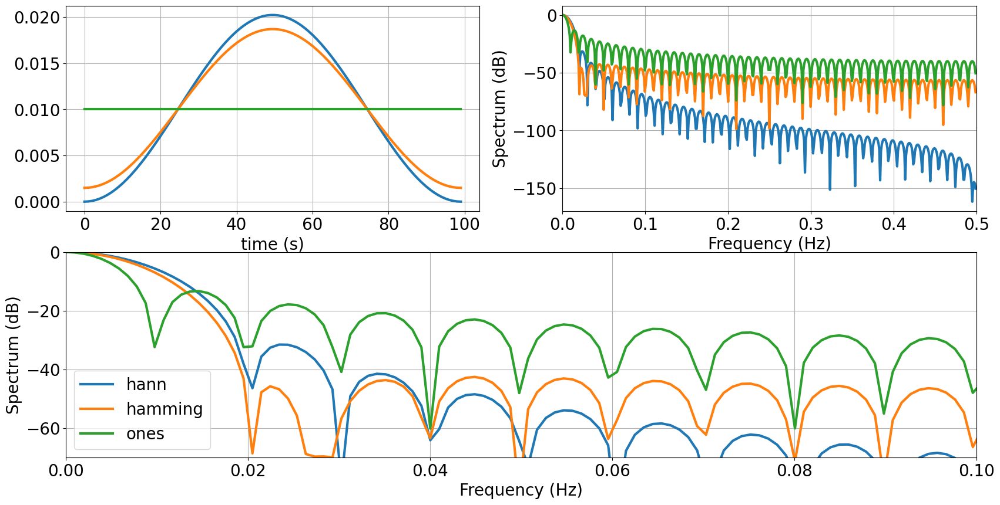

In [22]:
win_len = 100
n_fft = 1024
plt.figure()
ax1 = plt.subplot(2, 2, 1)
ax2 = plt.subplot(2, 2, 2)
ax3 = plt.subplot(2, 1, 2)
for w_fun in [hann, hamming, np.ones]:
    w = w_fun(win_len)
    w /= np.sum(w)  # normalisation, optionnelle
    
    plt.sca(ax1)
    plot_sound(w, fs=1)
    plt.sca(ax2)
    plot_spectrum(w, fs=1, n_fft=n_fft)
    plt.xlim(0, 0.5)
    plt.sca(ax3)
    plot_spectrum(w, fs=1, n_fft=n_fft, label=str(w_fun.__name__))
    plt.xlim(0, 0.1)
    plt.ylim(-70, 0)
plt.legend()

### Paramètres du spectrogramme: à retenir

* pas et nombre de fréquences: ajustement de la discrétisation en temps et en fréquence
* forme et longueur de la fenêtre: choix important pour ajuster le compromis de résolution temps-fréquence
  * fenêtre longue = bonne résolution fréquentielle
  * fenêtre courte = bonne résolution temporelle, 

### Exercice (optionnel)
Sur un son de parole (par exemple `50.wav`) rééchantillonné à 8000 Hz, extrayez une portion contenant un ou deux mots et affichez le spectrogramme en faisant varier la taille de la fenêtre pour faire apparaitre les différentes composantes fréquentielles de la voix (bonne précision fréquentielle) ou les formants (faible précision fréquentielle). Les formants sont des zones fréquentielles correspondant à des résonnances du conduit vocal; les deux premiers formants permettent de caractériser précisément les voyelles.

In [23]:
# TODO


### Interprétation comme un banc de filtres

...ou comment le spectrogramme est *"une couche convolutive avec K filtres $\mathbf{h}_k$ passe-bande autour des $\nu_k$, stride=pas, fonction d'activation $|.|^2$"*. 

Précédemment, on a vu que chaque colonne de la TFCT pouvait être considérée comme la TFD d'une trame.
Une autre interprétation existe en considérant les lignes de la TFT: chaque ligne de la TFCT peut être considérée comme la sortie d'un filtre. En prenant un pas égal à 1 (recouvrement maximal, $t_n=n$), et en considérant une ligne $k$ fixée, on a

$$
\mathbf{X}[k, n] 
= \sum_m \mathbf{x}\left[n+m\right] \mathbf{w}\left[m\right] e^{-2i\pi\frac{k m}{K}}
= \sum_m \mathbf{x}\left[n-m\right] \mathbf{h}_k(m)
$$
avec $\mathbf{h}_k(m)=\mathbf{w}\left[-m\right] e^{2i\pi\frac{k m}{K}}$. La $k$-ième ligne est donc la filtrage du signal $\mathbf{x}$ par le filtre de réponse impulsionnelle $\mathbf{h}_k$. Cette réponse impulsionnelle est un sinus à la fréquence $\nu_k=k/K$ fenêtré par $\mathbf{w}$, et sa réponse fréquentielle montre qu'il s'agit d'un fitre passe-bande qui laisse passer les fréquences autour de $\nu_k$.


(-100.0, 50.0)

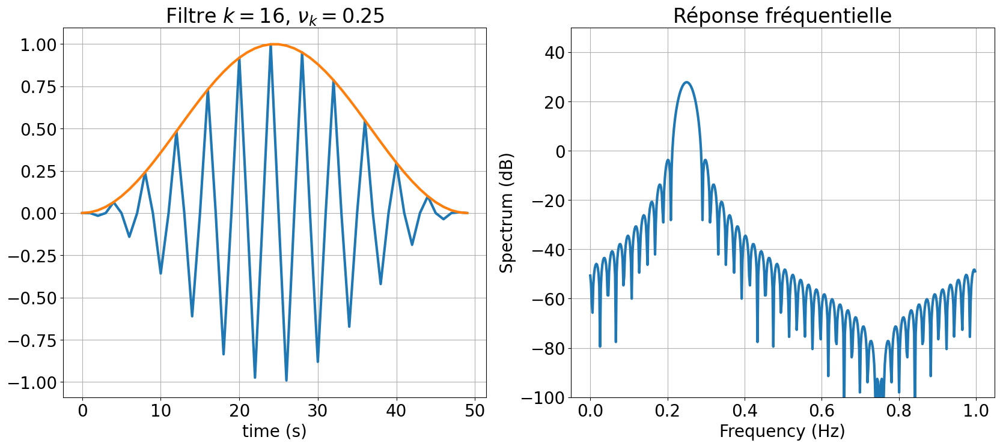

In [24]:
w_len = 50
w = hann(w_len)
k = 16
K = 64

hk = w[::-1] * np.exp(2*np.pi*1j*np.arange(w_len)*k/K)

plt.figure(figsize=(20, 8))
plt.subplot(121)
plot_sound(np.real(hk), fs=1, label='Réponse impulsionnelle')
plot_sound(w, fs=1, label='Fenêtre')
plt.title(r'Filtre $k={}$, $\nu_k={}$'.format(k, k/K))
plt.subplot(122)
plot_spectrum(hk, fs=1, n_fft=512)
plt.title('Réponse fréquentielle')
plt.ylim(-100, 50)

L'ensemble des lignes de la matrice TFCT constitue donc les sorties d'un *banc de filtres* constitués de K différents filtres dont les réponses fréquentielles forment un pavage de l'axe fréquentiel:

(-50.0, 40.0)

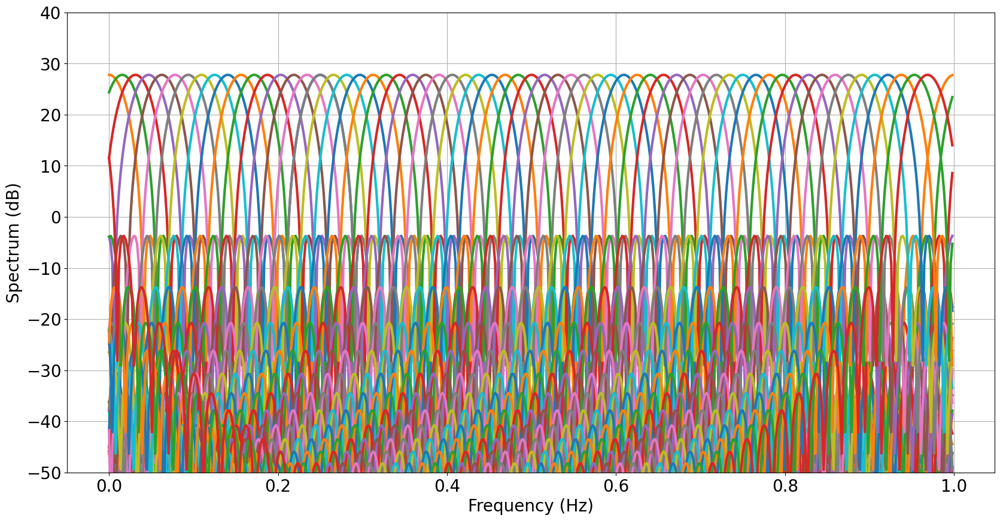

In [25]:
plt.figure()
for k in range(K):
    plot_spectrum(hk, fs=1, n_fft=512)
    hk = w[::-1] * np.exp(2*np.pi*1j*np.arange(w_len)*k/K)
plt.ylim(-50, 40)

## À retenir
* Le spectrogramme est la représentation la plus courante pour les sons
* TFCT = DFT sur une fenêtre glissante du signal
* Choix du pas et nombre de fréquences: discrétisation des axes temporel et fréquentiels
* Choix de la fenêtre et de sa taille: pour ajuster le compromis de localisation temps-fréquence
* On peut aussi voir la TFCT comme la sortie d'un banc de filtres

# Les représentations et features standards pour les sons

$\rightarrow$ Quels descripteurs peut-on utiliser? 

* Structure typique d'un système
* Les chromas
* Les MFCC
* Enrichissement avec les dérivées temporelles
* Intégration temporelle

## Structure typique d'un système

<img src="./figures/ex_feature_extraction.png" alt="source sep" width="700">

* Découpage en trames
* Représentation, extraction de descripteurs (*features*) dans chaque trame
* Normalisation éventuelle
* Pour une tâche d'apprentissage sur chaque trame: classification/régression/etc. de chaque trame
* Pour une tâche d'apprentissage sur chaque morceau
    * extraction de features pour chaque morceau par intégration temporelle des features des trames
    * classification/régression/etc. sur chaque morceau


## Les chromas

Principe:
* Vecteurs de taille 12, correspondant aux 12 demi-tons (très grossièrement, sorte de transcription sur une octave).
* Calculés à partir d'une transformée temps-fréquence comme le spectrogramme ou sa variante la transformée à Q-constant
* Pour chaque trame:
  * calculer le module carré de la transformée de Fourier / à Q constant
  * Agréger « modulo 12 demi-tons » les coefficients pour obtenir le vecteur de taille 12
* Bonne interprétabilité: reflète grossièrement la présence de chaque note dans une trame

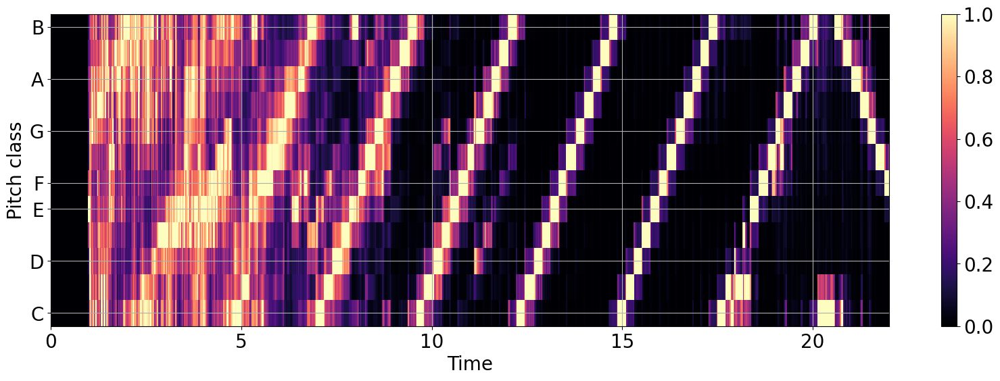

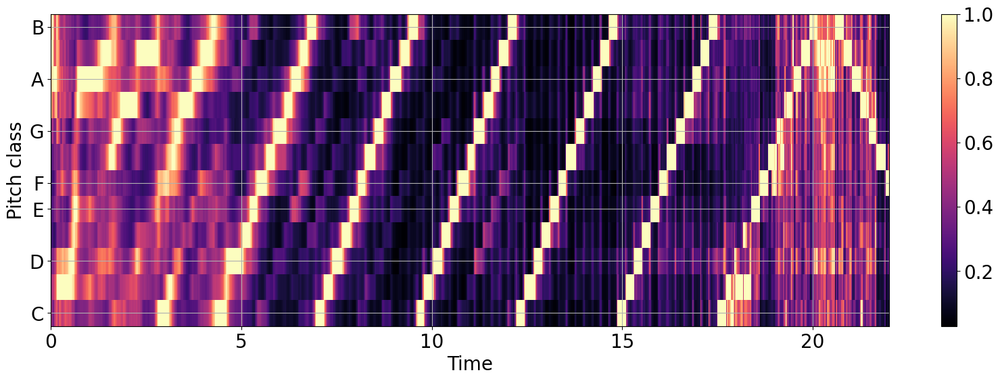

In [26]:
from librosa.feature import chroma_stft, chroma_cqt
from librosa.display import specshow

sound_file = 'data/MAPS_ISOL_CH0.1_M_AkPnCGdD_crop11.wav'
fs, x = read_wav(sound_file)

plt.figure(figsize=(20,6))
c_stft = chroma_stft(y=x, sr=fs)
specshow(c_stft, y_axis='chroma', x_axis='time')
plt.colorbar()

plt.figure(figsize=(20,6))
c_cqt = chroma_cqt(y=x, sr=fs)
specshow(c_cqt, y_axis='chroma', x_axis='time')
plt.colorbar()
Audio(filename='data/MAPS_ISOL_CH0.1_M_AkPnCGdD_crop11.mp3')

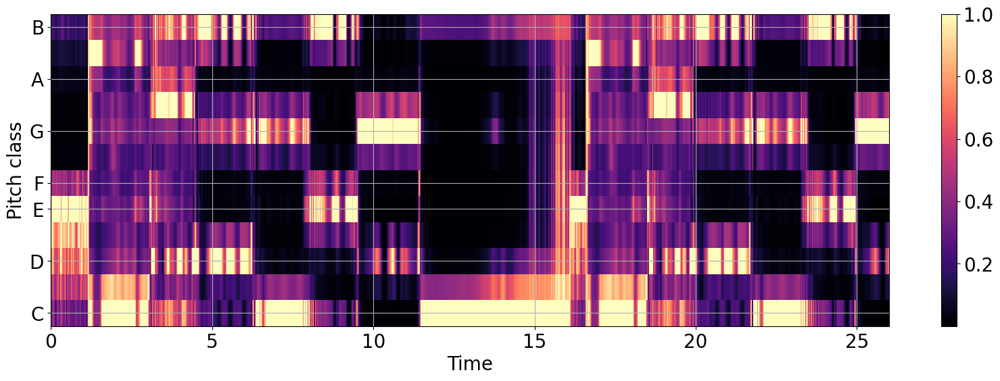

In [27]:
sound_file = sound_path1 / '18.wav'
fs, x = read_wav(sound_file)
x = x[:13*fs, 0]
plt.figure(figsize=(20,6))
c_stft = chroma_stft(y=x, sr=fs)
specshow(c_stft, y_axis='chroma', x_axis='time')
plt.colorbar()
Audio(filename='data/18.mp3')

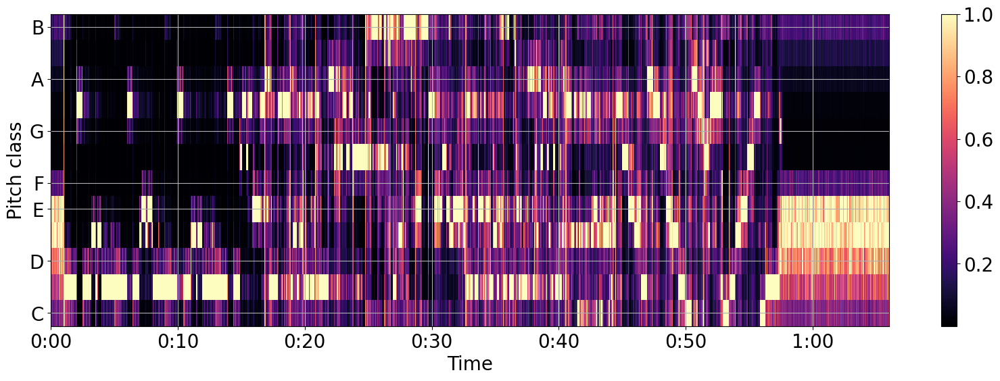

In [28]:
sound_file = sound_path1 / '69.wav'
fs, x = read_wav(sound_file)
x = x[:, 0]
plt.figure(figsize=(20,6))
c_stft = chroma_stft(y=x, sr=fs)
specshow(c_stft, y_axis='chroma', x_axis='time')
plt.colorbar()
Audio(filename='data/69.mp3')

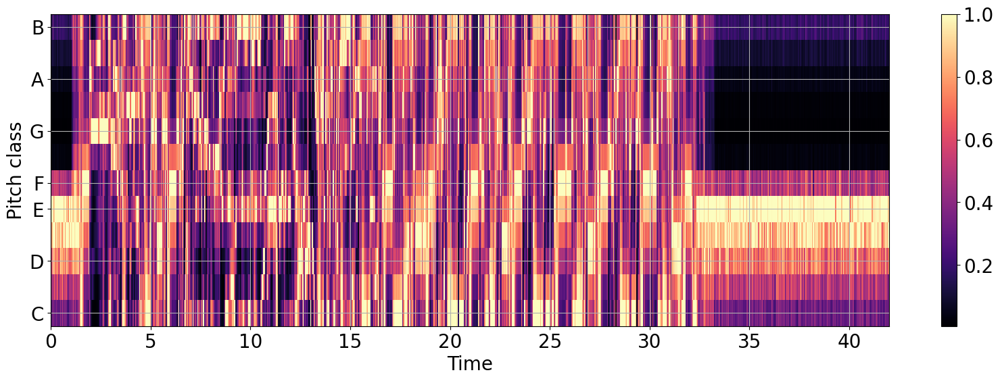

In [29]:
sound_file = sound_path1 / '70.wav'
fs, x = read_wav(sound_file)
x = x[:, 0]
plt.figure(figsize=(20,6))
c_stft = chroma_stft(y=x, sr=fs)
specshow(c_stft, y_axis='chroma', x_axis='time')
plt.colorbar()
Audio(filename='data/70.mp3')

## Les MFCC (*Mel-frequency cepstral coefficients*)
Principe:
* Largement utilisés pour le traitement de la parole, très efficaces aussi pour la musique.
* Calculés à partir d'une transformée temps-fréquence 
* Pour chaque trame :
  * calculer le module carré de la transformée de Fourier ;
  * modifier l’échelle fréquentielle : échelle mel (perceptive) ;
  * passer au log ;
  * appliquer une transformée en cosinus et prendre l’amplitude des premiers coefficients (≈ 20).
* 2 principes sous-jacents
  * Échelle mel: discrétisation des fréquences selon une échelle perceptive, avec résolution fine en basses fréquences et grossière en hautes fréquences
  * Notion de cepstre:
    * pipeline: $x\rightarrow \text{DFT} \rightarrow |.| \rightarrow \log(.) \rightarrow \text{iDFT}$
    * la convolution devient une somme: $\text{cepstre}(x * h) = \text{cepstre}(x) + \text{cepstre}(h)$
* Représentation compacte: très peu de coefficients pour décrire la forme du spectre.
* Faible interprétabilité, censé bien représenter les caractéristiques sources/filtre.

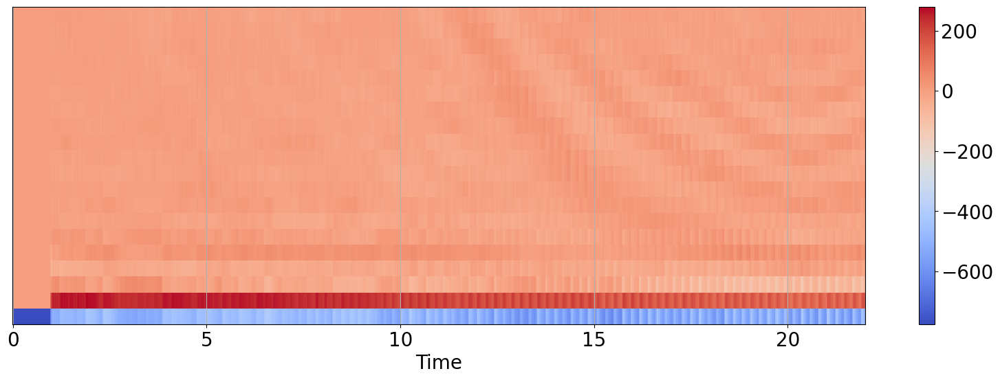

In [30]:
from librosa.feature import mfcc

sound_file = 'data/MAPS_ISOL_CH0.1_M_AkPnCGdD_crop11.wav'
fs, x = read_wav(sound_file)

plt.figure(figsize=(20,6))
x_mfcc = mfcc(y=x, sr=fs)
specshow(x_mfcc, x_axis='time')
plt.colorbar()
Audio(filename='data/MAPS_ISOL_CH0.1_M_AkPnCGdD_crop11.mp3')

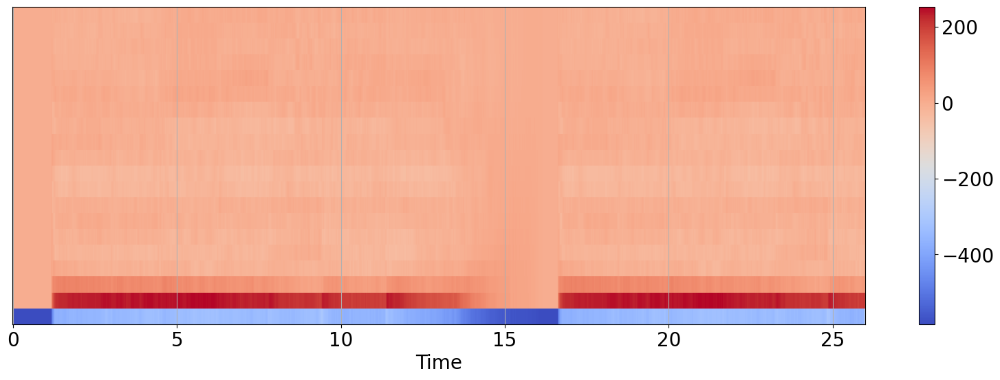

In [31]:
sound_file = sound_path1 / '18.wav'
fs, x = read_wav(sound_file)
x = x[:13*fs, 0]
plt.figure(figsize=(20,6))
x_mfcc = mfcc(y=x, sr=fs)
specshow(x_mfcc, x_axis='time')
plt.colorbar()
Audio(filename='data/18.mp3')

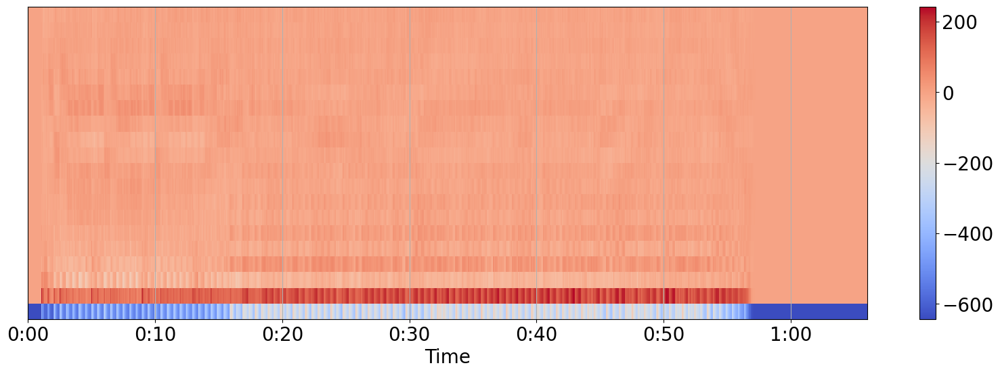

In [32]:
sound_file = sound_path1 / '69.wav'
fs, x = read_wav(sound_file)
x = x[:, 0]
plt.figure(figsize=(20,6))
x_mfcc = mfcc(y=x, sr=fs)
specshow(x_mfcc, x_axis='time')
plt.colorbar()
Audio(filename='data/69.mp3')

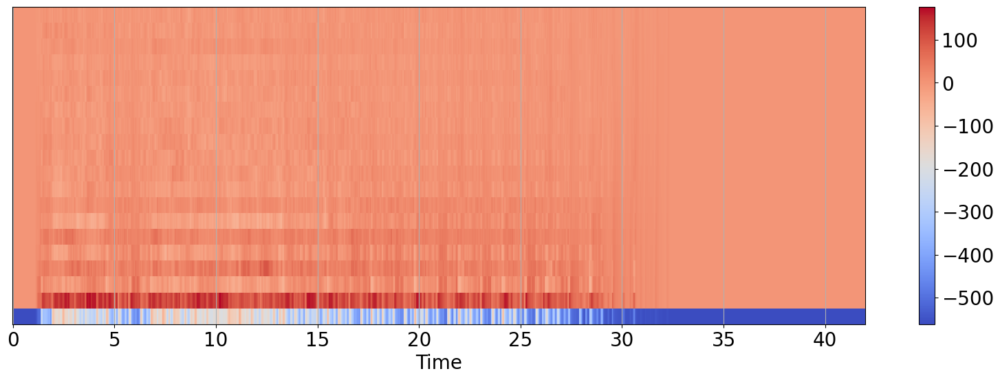

In [33]:
sound_file = sound_path1 / '70.wav'
fs, x = read_wav(sound_file)
x = x[:, 0]
plt.figure(figsize=(20,6))
x_mfcc = mfcc(y=x, sr=fs)
specshow(x_mfcc, x_axis='time')
plt.colorbar()
Audio(filename='data/70.mp3')

## Les $\Delta$MFCC, $\Delta\Delta$MFCC, $\Delta$chroma, $\Delta\Delta$chroma

Principe: enrichir les MFCC ou chroma avec leurs dérivées temporelles discrètes d'ordre 1 et 2.

Le vecteur de descripteurs est alors:
$$
\begin{pmatrix}
z_t\\
\Delta z_t\\
\Delta \Delta z_t
\end{pmatrix}
$$

où
* $z_t$ est le vecteur de MFCC ou chroma à la trame $t$
* $\Delta z_t = z_{t+1} - z_{t}$
* $\Delta\Delta z_t = \Delta z_{t+1} - \Delta z_t = z_{t+1} - 2 z_{t} + z_{t-1}$

En pratique: fonction `librosa.feature.delta`.

## Intégration temporelle

<img src="./figures/feature_aggregation.png" alt="source sep" width="700">

La séquence $z_t\in\mathbb{R}^d$ de descripteurs des trames $t$ peut être aggrégée en un vecteur de descripteurs pour le son entier, par exemple:
* en prenant la moyenne temporelle de chacun des $d$ descripteurs, et éventuellement la matrice de covariance empirique,
* ou en construisant un histogramme pour chacun des $d$ descripteurs, ou un histogramme global à $d$ dimensions.


# Les représentations et features standards pour les images
* Représentation temps/échelle: les ondelettes
* Les HOG
* Les SIFT


## Représentation temps/échelle: les ondelettes
Pour les images, on utilise des transformées en ondelettes plutôt que les transformées temps-fréquence comme le spectrogramme:
* La notion de fréquence est remplacée par la notion d'échelle
* Une ondelette est un motif de base, par exemple un filtre $[-1, 1]$
* On considère ce motif à différentes échelles et différentes positions dans l'image
* On en extrait un jeu de coefficients par des opérations de filtrage et de sous-échantillonnage.

Voir
* [skimage.feature.haar_like_feature](https://scikit-image.org/docs/stable/auto_examples/applications/plot_haar_extraction_selection_classification.html#sphx-glr-auto-examples-applications-plot-haar-extraction-selection-classification-py)
* TP3

## Les HOG (Histogram of gradients)
* Idée: la distribution des gradients de l'image contient une information très représentative (contours, textures, invariance aux conditions d'éclairage)
* Principe de calcul:
  * On divise l'image en $P\times Q$ cellules
  * Dans chaque cellule, on calcule un histogramme des gradients, chaque bin étant associé à une orientation par parmi $B$ du gradient, la norme du gradient pondérant les coefficients de l'histogramme
  * On vectorise ensuite le résultat
* Taille du vecteur de features: $PQB$.

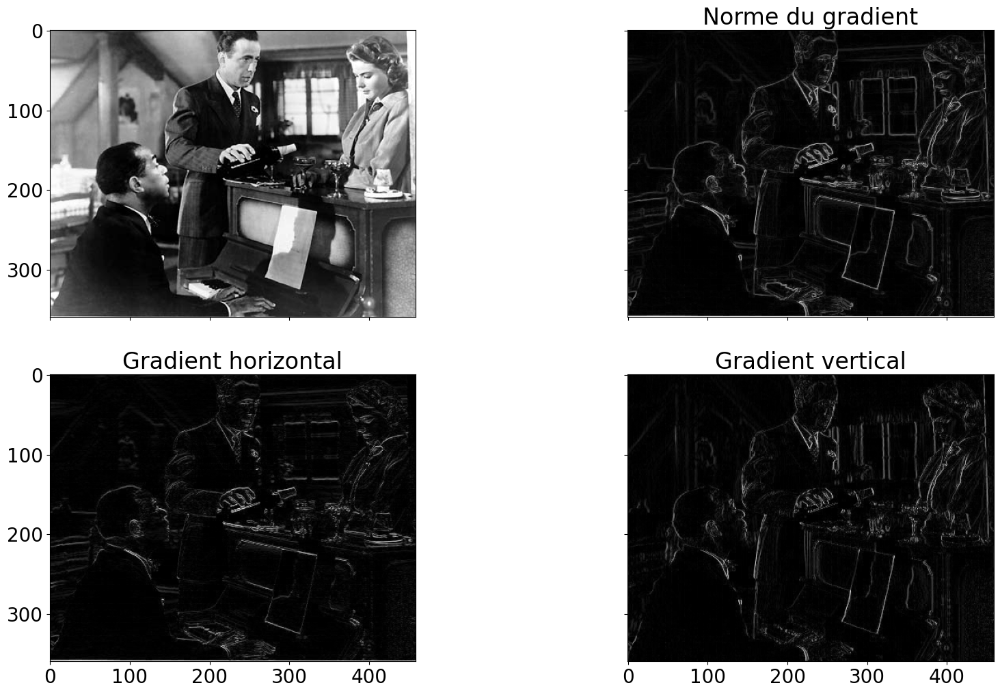

In [34]:
filename = '../../data/images/casablanca.png'
X = plt.imread(filename)

fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(20, 12), sharex=True, sharey=True)
ax1.imshow(X, cmap='gray')
ax1.grid(False)
ax2.imshow(np.sqrt(np.diff(X, axis=0)[:,:-1]**2+np.diff(X, axis=1)[:-1,:]**2), cmap='gray')
ax2.set_title('Norme du gradient')
ax2.grid(False)
ax3.imshow(np.abs(np.diff(X, axis=0)), cmap='gray')
ax3.set_title('Gradient horizontal')
ax3.grid(False)
ax4.imshow(np.abs(np.diff(X, axis=1)), cmap='gray')
ax4.set_title('Gradient vertical')
ax4.grid(False)

(72,)
(72,)
(72,)
(72,)
(72,)


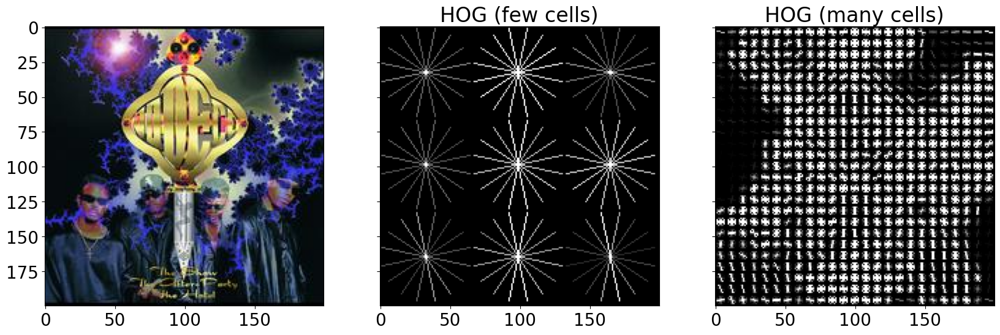

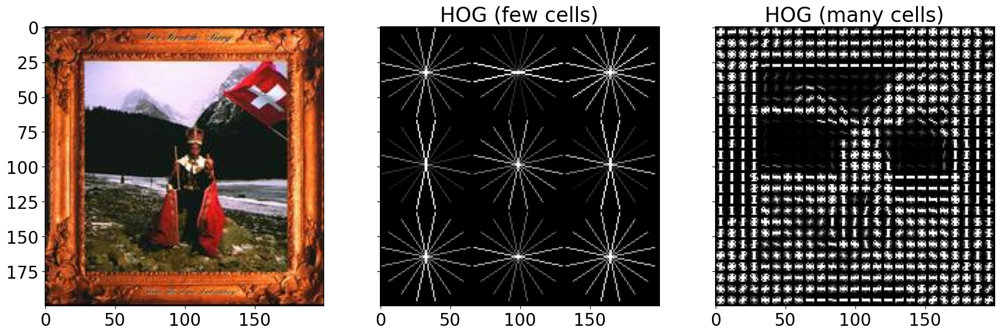

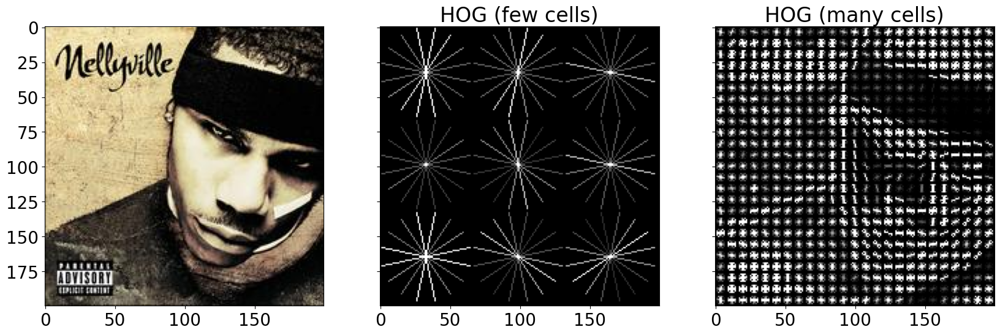

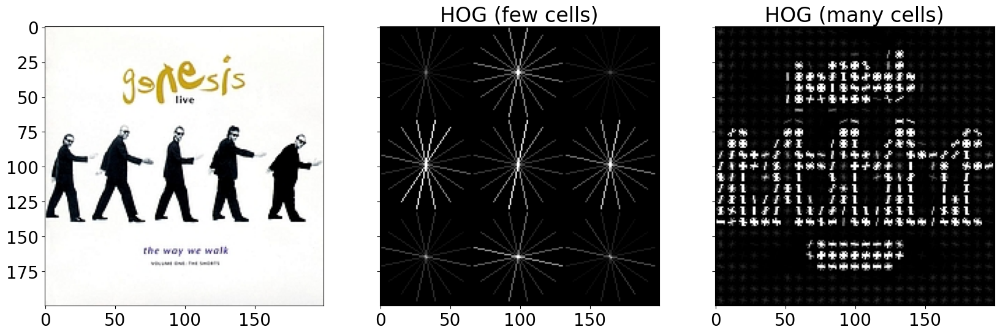

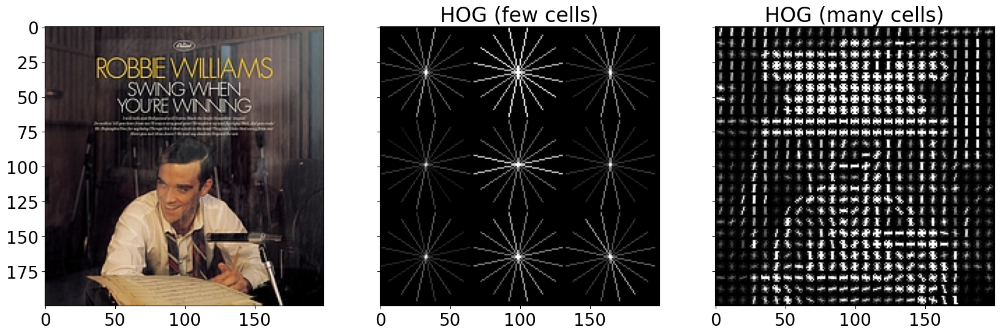

In [35]:
from skimage.feature import hog
from skimage import exposure
image_path = Path('./data/')
P = Q = 3
B = 8
for filename in ('0000000017_200.jpg', '0000000041_200.jpg', '0000000046_200.jpg',
                '0000000284_200.jpg', '0000000597_200.jpg'): 
    X = plt.imread(image_path / filename)
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 6), sharex=True, sharey=True)

    ax1.imshow(X, cmap=plt.cm.gray)
    ax1.grid(False)

    hog_vector, hog_image = hog(X, orientations=B, pixels_per_cell=(X.shape[0]//P, X.shape[1]//Q),
                        cells_per_block=(1, 1), visualize=True, channel_axis=2)
    print(hog_vector.shape)
    # Rescale histogram for better display
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

    ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    ax2.set_title('HOG (few cells)')
    ax2.grid(False)

    hog_vector, hog_image = hog(X, orientations=B, pixels_per_cell=(8, 8),
                                cells_per_block=(1, 1), visualize=True, channel_axis=2)
    # Rescale histogram for better display
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

    ax3.imshow(hog_image_rescaled, cmap=plt.cm.gray)
    ax3.set_title('HOG (many cells)')
    ax3.grid(False)

## Les [SIFT](https://scikit-image.org/docs/stable/auto_examples/features_detection/plot_sift.html)
* Idée:
  * Détecter les points clés
  * Leur assigner une position $(x, y)$, un paramètre d'échelle $\sigma$ et une orientation $\theta$
  * Propriétés d'invariance par translation, rotation, changement d'échelle
* Principe de calcul:
  * Filtres gaussiens à plusieurs échelles $\sigma$
  * Calcul du gradient à chaque échelle
  * Localisation des maxima locaux des gradients

Nombreuses variantes dont [ORB](https://scikit-image.org/docs/stable/api/skimage.feature.html#skimage.feature.ORB) plus rapides à calculer.

<img src="./figures/exemple_sift.jpg" alt="700" width="700">


<img src="./figures/sphx_glr_plot_sift_001_crop.png" alt="SIFT" width="800">


# En guise de conclusion

* notion de spectrogramme:
  * votre photoshop pour analyser un son,
  * la base pour construire les descripteurs,
  * attention à la paramétrisation de la fenêtre.
* descripteurs:
  * descripteurs de son: MFCC, Chroma, et leurs dérivées d'ordres 1 et 2
  * descripteurs d'images: ondelettes, HOG, SIFT pour les plus célèbres
  * remarque: ce sont des combinaisons de linéarités (convolutions, multiplications, etc.), non-linéarités, échantillonnages